# Appendix A

## Import Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn import preprocessing
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import recall_score 
from sklearn.metrics import precision_score  
from sklearn.metrics import roc_auc_score 
from sklearn.metrics import roc_curve 
from sklearn.metrics import classification_report
from sklearn import metrics


%matplotlib inline
sns.set_context('notebook') 

# Load Dataset

In [2]:
data = pd.read_csv("900 amp and del from fisher exact.csv")
print(data.shape)
# data.head()

(57, 988)


In [3]:
seed = 0
all_columns=data.iloc[:,:]

# Correlation matrix

In [4]:
# Create correlation matrix
corr_matrix = all_columns.corr().abs()
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)

In [5]:
# Find index of feature columns with correlation greater than 0.25 to Gemcitabine

corr_matrix = corr_matrix[corr_matrix["Gemcitabine Response"] >= 0.27]
# print(corr_matrix.shape)
# print(corr_matrix.index)
corr_matrix.head()

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)

pd.DataFrame(corr_matrix)

,Gemcitabine Response,PHOX2B,LINC00682,TMEM33,DCAF4L1,SLC30A9,BEND4,SHISA3,ATP8A1,GRXCR1,RN7SKP82,COX7B2,GABRA4,GABRB1,snoU13|ENSG00000238301.1,COMMD8,ATP10D,CORIN,RN7SKP215,NFXL1,NIPAL1,CNGA1,TXK,CWH43,FRYL,OCIAD1,OCIAD2,SLAIN2,SLC10A4,TEC,ZAR1,KIT,RN7SL205P,SNORA70|ENSG00000252014.1,HHIP,ANAPC10,RN7SKP235,ABCE1,OTUD4,SMAD1,MMAA,C4orf51,ZNF827,LSM6,SLC10A7,POU4F2,TTC29,MIR548G,EDNRA,TMEM184C,PRMT10,ARHGAP10,RNA5SP165,MIR4799,RN7SL254P,DCLK2,LRBA,MAB21L2,RNA5SP168,RPS3A,SH3D19,SNORD73,SNORD73A,PRSS48,FAM160A1,RN7SKP35,PET112,RNA5SP169,RN7SL446P,FBXW7,MIR3140,MIR4453,TMEM154,TIGD4,ARFIP1,FHDC1,TRIM2,MND1,RN7SL419P,KIAA0922,TLR2,RNF175,SFRP2,DCHS2,PLRG1,FGB,FGA,FGG,LRAT,RBM46,NPY2R,MAP9,GUCY1A3,GUCY1B3,ASIC5,TDO2,CTSO,B4GALNT3,CCDC77,FAM138D,IQSEC3,KDM5A,NINJ2,RNU4ATAC16P,SLC6A12,SLC6A13,WNK1,RAD52,ERC1,RN7SL852P,ADIPOR2,FBXL14,LINC00942,MIR3649,WNT5B,CACNA2D4,LRTM2,LINC00940,DCP1B,CACNA1C,CBX3P4,FKBP4,ITFG2,NRIP2,FOXM1,RHNO1,TULP3,TEAD4,TSPAN9,PRMT8,EFCAB4B,PARP11,CCND2,CD4,MANSC1,LOH12CR2,LOH12CR1,DUSP16,CREBL2,GPR19,CDKN1B,APOLD1,MIR613,DDX47,GPRC5A,GPRC5D,GSG1,HEBP1,HTR7P1,KIAA1467,MIR614,SNORD88,H2AFJ,HIST4H4,WBP11,C12orf60,SMCO3,ART4,MGP,ERP27,ARHGDIB,PDE6H,RERG,BCAT1,C12orf77,LRMP,CASC1,LYRM5,KRAS,RASSF8,BHLHE41,SSPN,ITPR2,RNA5SP354,ASUN,FGFR1OP2,TM7SF3,MED21,C12orf71,STK38L,MANSC4,KLHL42,RN7SKP15,PTHLH,KIF21A,ABCD2,C12orf40,SLC2A13,SNORA22|ENSG00000199571.1,LRRK2,MUC19,CNTN1,PDZRN4,RNA5SP360,GXYLT1,YAF2,PPHLN1,RN7SL10P,ZCRB1,SNORA74|ENSG00000252917.1,PRICKLE1,ADAMTS20,PUS7L,IRAK4,TWF1,TMEM117,NELL2,DBX2,RNA5SP361,PLEKHA8P1,ANO6,ARID2,RN7SL246P,SCAF11,SLC38A1,SLC38A2,SLC38A4,AMIGO2,PCED1B,MIR4698,SNORA64|ENSG00000199566.1,MIR4494,RPAP3,ENDOU,RAPGEF3,SLC48A1,HDAC7,VDR,TMEM106C,COL2A1,SENP1,PFKM,ASB8,C12orf68,DKFZP779L1853,OR10AD1,H1FNT,ZNF641,ANP32D,C12orf54,OR8S1,LALBA,KANSL2,SNORA34,SNORA2A,SNORA2B,CCNT1,LINC00935,OR6C65,OR6C76,...,MIR450B,MIR503HG,MIR542,MIR503,LINC00629,PLAC1,FAM122B,FAM122C,MOSPD1,SMIM10,FAM127C,FAM127A,FAM127B,LINC00087,LINC00633,CT45A1,CT45A2,CT45A3,CT45A4,CT45A5,CT45A6,CXorf48,DDX26B,LINC00086,RNA5SP515,SAGE1,ZNF449,ZNF75D,MMGT1,SLC9A6,snoU13|ENSG00000239080.1,FHL1,MAP7D3,GPR112,BRS3,HTATSF1,VGLL1,MIR934,LINC00892,CD40LG,ARHGEF6,RBMX,SNORD61|ENSG00000206979.1,GPR101,ZIC3,RN7SL325P,RN7SKP31,FGF13,MIR504,F9,MCF2,ATP11C,CXorf66,MIR505,RN7SL727P,RNU6ATAC23P,SNORA18|ENSG00000252719.1,snoU13|ENSG00000238485.1,SOX3,LINC00632,CDR1,MIR320D2,SPANXB1,SPANXB2,LDOC1,MAGEC1,MAGEC3,SPANXA1,SPANXA2,SPANXC,SPANXD,MAGEC2,RNA5SP516,snoU13|ENSG00000239188.1,SPANXN4,RN7SKP81,RN7SKP149,SPANXN3,SLITRK4,SPANXN2,UBE2NL,RN7SKP189,SPANXN1,SLITRK2,TMEM257,MIR888,MIR890,MIR892A,MIR892B,MIR891B,MIR891A,RNA5SP517,CXorf51A,CXorf51B,MIR513C,MIR513B,MIR513A1,MIR513A2,MIR506,MIR507,MIR508,MIR514B,MIR510,MIR514A1,MIR514A2,MIR514A3,FMR1,FMR1NB,AFF2,RN7SKP267,IDS,LINC00893,CXorf40A,CXorf40B,HSFX1,HSFX2,LINC00894,MAGEA11,MAGEA8,MAGEA9,MAGEA9B,TMEM185A,MIR2114,MAMLD1,MTM1,MTMR1,CD99L2,U3|ENSG00000253009.1,HMGB3,MIR4330,GPR50,VMA21,PASD1,PRRG3,FATE1,CNGA2,MAGEA4,GABRE,MIR224,MIR452,MAGEA10,GABRA3,MIR767,GABRQ,CETN2,CSAG1,CSAG2,CSAG3,CSAG4,MAGEA1,MAGEA12,MAGEA2,MAGEA2B,MAGEA3,MAGEA6,NSDHL,PNMA3,PNMA5,PNMA6A,PNMA6B,PNMA6C,PNMA6D,RN7SL190P,RN7SL667P,ZFP92,ZNF185,ZNF275,snoU13|ENSG00000239037.1,HAUS7,TREX2,BGN,ATP2B3,FAM58A,DUSP9,RN7SL687P,PNCK,SLC6A8,BCAP31,ABCD1,PLXNB3,IDH3G,SRPK3,SSR4,PDZD4,SNORD36|ENSG00000251846.1,L1CAM,LCA10,AVPR2,ARHGAP4,NAA10,RENBP,HCFC1,TMEM187,IRAK1,MECP2,MIR718,OPN1LW,OPN1MW,OPN1MW2,TEX28,TEX28P1,TEX28P2,TKTL1,EMD,FLNA,RPL10,SNORA70|ENSG00000207165.1,DNASE1L1,TAZ,ATP6AP1,FAM50A,GDI1,PLXNA3,LAGE3,UBL4A,SLC10A3,RN7SL697P,RN7SL742P,FAM3A,G6PD,IKBKG,BRCC3,CLIC2,CMC4,CTAG1A,CTAG1B,CTAG2,DKC1,F8,F8A1,F8A2,F8A3,FUNDC2,GAB3,H2AFB1,H2AFB2,H2AFB3,MPP1,MTCP1,RAB39B,SMIM9,SNORA36A,SNORA56,TMLHE,VBP1,IL9R|ENSG00000124334.12,SPRY3|ENSG00000168939.6,VAMP7|ENSG00000124333.10,WASH6P|ENSG00000182484.10,WASIR1|ENSG00000185203.7
Gemcitabine Response,1.000000,0.327095,0.327095,0.327095,0.327095,0.327095,0.327095,0.327095,0.327095,0.327

In [6]:
listallcols=list(corr_matrix.columns)


In [7]:
colstokeep=list(corr_matrix.index)


In [8]:
colstodrop=set(listallcols)-set(colstokeep)
colstodrop=list(colstodrop)

In [9]:
df_corr_matrix_final=corr_matrix[colstokeep]
print(df_corr_matrix_final.shape)
# df_corr_matrix_final

(531, 531)


In [10]:
top = df_corr_matrix_final.columns
data[top]

,Gemcitabine Response,PHOX2B,LINC00682,TMEM33,DCAF4L1,SLC30A9,BEND4,SHISA3,ATP8A1,GRXCR1,RN7SKP82,COX7B2,GABRA4,GABRB1,snoU13|ENSG00000238301.1,COMMD8,ATP10D,CORIN,RN7SKP215,NFXL1,NIPAL1,CNGA1,TXK,CWH43,FRYL,OCIAD1,OCIAD2,SLAIN2,SLC10A4,TEC,ZAR1,KIT,RN7SL205P,SNORA70|ENSG00000252014.1,HHIP,ANAPC10,RN7SKP235,ABCE1,OTUD4,SMAD1,MMAA,C4orf51,ZNF827,LSM6,SLC10A7,POU4F2,TTC29,MIR548G,EDNRA,TMEM184C,PRMT10,ARHGAP10,RNA5SP165,MIR4799,RN7SL254P,DCLK2,LRBA,MAB21L2,RPS3A,SH3D19,SNORD73,SNORD73A,PRSS48,FBXW7,MIR3140,MIR4453,TMEM154,TIGD4,ARFIP1,FHDC1,TRIM2,MND1,RN7SL419P,KIAA0922,LRAT,RBM46,NPY2R,MAP9,GUCY1A3,GUCY1B3,ASIC5,TDO2,CTSO,B4GALNT3,CCDC77,FAM138D,IQSEC3,KDM5A,NINJ2,RNU4ATAC16P,SLC6A12,SLC6A13,WNK1,RAD52,ERC1,RN7SL852P,ADIPOR2,FBXL14,LINC00942,MIR3649,WNT5B,CACNA2D4,LRTM2,LINC00940,DCP1B,CACNA1C,CBX3P4,FKBP4,ITFG2,NRIP2,FOXM1,RHNO1,TULP3,TEAD4,TSPAN9,PRMT8,PDZRN4,RNA5SP360,GXYLT1,YAF2,PPHLN1,RN7SL10P,ZCRB1,SNORA74|ENSG00000252917.1,PRICKLE1,ADAMTS20,PUS7L,IRAK4,TWF1,TMEM117,NELL2,DBX2,RNA5SP361,PLEKHA8P1,ANO6,ARID2,RN7SL246P,SCAF11,SLC38A1,SLC38A2,SLC38A4,AMIGO2,PCED1B,MIR4698,SNORA64|ENSG00000199566.1,MIR4494,RPAP3,ENDOU,RAPGEF3,SLC48A1,HDAC7,VDR,TMEM106C,COL2A1,SENP1,PFKM,ASB8,C12orf68,DKFZP779L1853,OR10AD1,H1FNT,ZNF641,ANP32D,C12orf54,OR8S1,LALBA,KANSL2,SNORA34,SNORA2A,SNORA2B,CCNT1,LINC00935,OR6C65,OR6C76,OR6C2,OR6C70,OR6C68,OR6C4,SNORA19|ENSG00000251822.1,GRIP1,TSPAN8,LGR5,ZFC3H1,SNORA17|ENSG00000212461.1,THAP2,TMEM19,RAB21,TBC1D15,TPH2,TRHDE,DCUN1D1,MCCC1,LAMP3,MCF2L2,TMEM41A,LIPH,SENP2,IGF2BP2,C3orf65,MIR548AQ,TRA2B,RN7SL637P,ETV5,DGKG,CRYGS,TBCCD1,DNAJB11,AHSG,FETUB,HRG,KNG1,EIF4A2,SNORD2|ENSG00000238942.1,RFC4,SNORA4|ENSG00000263776.1,SNORA63|ENSG00000200320.1,SNORA63|ENSG00000200418.1,SNORA81|ENSG00000221420.2,ADIPOQ,ST6GAL1,RPL39L,RTP1,MASP1,RTP4,snoU13|ENSG00000239093.1,SST,RTP2,BCL6,LPP,MIR28,HNRNPC,RPGRIP1,SUPT16H,HNRNPM,PRAM1,ZNF414,MYO1F,ADAMTS10,ACTL9,OR2Z1,ZNF558,MBD3L1,MUC16,OR1M1,OR7G2,OR7G1,OR7G3,ZNF317,OR7D2,OR7D4,...,MIR652,MIR3978,AMMECR1,SNORD96B,GNG5P2,RGAG1,TDGF1P3,CHRDL1,PAK3,CAPN6,DCX,LINC00890,RN7SL661P,ALG13,RNA5SP512,TRPC5,TRPC5OS,ZCCHC16,LHFPL1,AMOT,MIR4329,RN7SL266P,snoU13|ENSG00000238811.1,U3|ENSG00000201674.1,RN7SL93P,SNORD30,HTR2C,SNORA35|ENSG00000208839.1,MIR764,MIR1912,MIR1298,MIR1911,MIR448,IL13RA2,LRCH2,LUZP4,RBMXL3,SNORA35|ENSG00000271907.1,SNORA64|ENSG00000252441.1,PLS3,RN7SL712P,AGTR2,SLC6A14,CXorf61,KLHL13,WDR44,MIR1277,DOCK11,IL13RA1,SNORA35|ENSG00000239182.1,ZCCHC12,LONRF3,KIAA1210,PGRMC1,RN7SL118P,SLC25A43,SLC25A5,CXorf56,UBE2A,NKRF,6-Sep,MIR766,SOWAHD,RPL39,SNORA69|ENSG00000206622.1,UPF3B,NDUFA1,RNF113A,AKAP14,NKAP,RHOXF2B,RHOXF1,NKAPP1,RHOXF2,ZBTB33,TMEM255A,ATP1B4,LAMP2,CUL4B,snoU13|ENSG00000272179.1,MCTS1,C1GALT1C1,CT47A1,CT47A10,CT47A11,CT47A12,CT47A2,CT47A3,CT47A4,CT47A5,CT47A6,CT47A7,CT47A8,CT47A9,CT47B1,GLUD2,MIR3672,U3|ENSG00000212321.1,GRIA3,THOC2,RN7SL29P,XIAP,STAG2,snoU13|ENSG00000239058.1,SNORA40|ENSG00000252693.1,SH2D1A,TENM1,snoU13|ENSG00000238626.1,CXorf64,AFF2,IDS,LINC00893,CXorf40A,CXorf40B,HSFX1,HSFX2,LINC00894,MAGEA11,MAGEA8,MAGEA9,MAGEA9B,TMEM185A,MIR2114,MAMLD1,MTM1,MTMR1,CD99L2,U3|ENSG00000253009.1,HMGB3,MIR4330,GPR50,VMA21,PASD1,PRRG3,FATE1,CNGA2,MAGEA4,GABRE,MIR224,MIR452,MAGEA10,GABRA3,MIR767,GABRQ,CETN2,CSAG1,CSAG2,CSAG3,CSAG4,MAGEA1,MAGEA12,MAGEA2,MAGEA2B,MAGEA3,MAGEA6,NSDHL,PNMA3,PNMA5,PNMA6A,PNMA6B,PNMA6C,PNMA6D,RN7SL190P,RN7SL667P,ZFP92,ZNF185,ZNF275,snoU13|ENSG00000239037.1,HAUS7,TREX2,BGN,ATP2B3,FAM58A,DUSP9,RN7SL687P,PNCK,SLC6A8,BCAP31,ABCD1,PLXNB3,IDH3G,SRPK3,SSR4,PDZD4,SNORD36|ENSG00000251846.1,L1CAM,LCA10,AVPR2,ARHGAP4,NAA10,RENBP,HCFC1,TMEM187,IRAK1,MECP2,MIR718,OPN1LW,OPN1MW,OPN1MW2,TEX28,TEX28P1,TEX28P2,TKTL1,EMD,FLNA,RPL10,SNORA70|ENSG00000207165.1,DNASE1L1,TAZ,ATP6AP1,FAM50A,GDI1,PLXNA3,LAGE3,UBL4A,SLC10A3,RN7SL697P,RN7SL742P,FAM3A,G6PD,IKBKG,BRCC3,CLIC2,CMC4,CTAG1A,CTAG1B,CTAG2,DKC1,F8,F8A1,F8A2,F8A3,FUNDC2,GAB3,H2AFB1,H2AFB2,H2AFB3,MPP1,MTCP1,RAB39B,SMIM9,SNORA36A,SNORA56,TMLHE,VBP1,IL9R|ENSG00000124334.12,SPRY3|ENSG00000168939.6,VAMP7|ENS

# Inspection of the skewness of features

In [11]:
#To check skewness
# calculate the skewnes before transformation
from scipy.stats import skew

transform= data[top[1:]]

for i in transform:
    print('Skewness of {0} is :{1}'.format(i, skew(df_corr_matrix_final[i])))

transform.shape

Skewness of PHOX2B is :1.3890262619358107
Skewness of LINC00682 is :1.3890262619358107
Skewness of TMEM33 is :1.3890262619358107
Skewness of DCAF4L1 is :1.3890262619358107
Skewness of SLC30A9 is :1.3890262619358107
Skewness of BEND4 is :1.3890262619358107
Skewness of SHISA3 is :1.3890262619358107
Skewness of ATP8A1 is :1.3890262619358107
Skewness of GRXCR1 is :1.3890262619358107
Skewness of RN7SKP82 is :1.3890262619358107
Skewness of COX7B2 is :2.24054537275152
Skewness of GABRA4 is :2.24054537275152
Skewness of GABRB1 is :2.24054537275152
Skewness of snoU13|ENSG00000238301.1 is :2.24054537275152
Skewness of COMMD8 is :2.2745445162591436
Skewness of ATP10D is :2.24054537275152
Skewness of CORIN is :2.24054537275152
Skewness of RN7SKP215 is :2.24054537275152
Skewness of NFXL1 is :2.24054537275152
Skewness of NIPAL1 is :2.24054537275152
Skewness of CNGA1 is :2.24054537275152
Skewness of TXK is :2.24054537275152
Skewness of CWH43 is :2.24054537275152
Skewness of FRYL is :2.24054537275152


(57, 530)

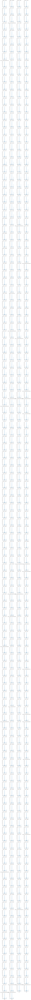

In [56]:
# # show distribution plot of other columns
# # use pd.melt to unpivot all quantitative variables and values
# # data are “unpivoted” to the row axis, leaving just two non-identifier columns, ‘variable’ and ‘value’
f=pd.melt(data, value_vars=transform)
g = sns.FacetGrid(f, col="variable",  col_wrap=4, sharex=False, sharey=False)
g = g.map(sns.distplot, "value")

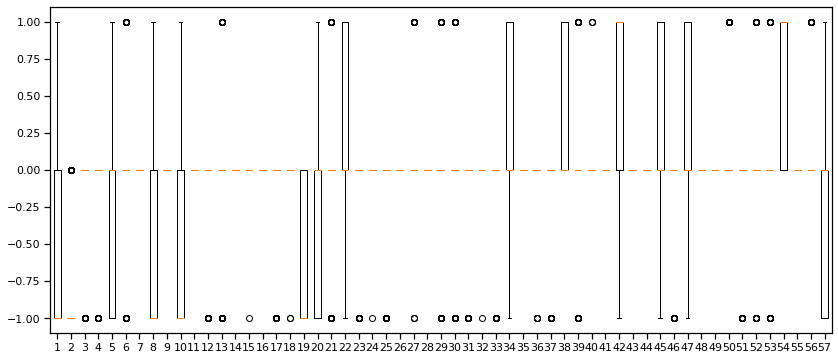

In [58]:
fig = plt.figure(1, figsize=(14,6))
ax = fig.add_subplot(111)
bp = ax.boxplot(data[top].iloc[:,1:])
fig.savefig('fig1.png',bbox_inches='tight')

# Train and Test set split

In [12]:
from sklearn.model_selection import train_test_split

# try to use only important quantitative columns + binary columns
## define x_topf and y_topf
X= data[top].iloc[:,1:].values
print(type(X))
print(X.shape)

y = data[top].iloc[:,0].values
print(type(y))
print(y)


# create x_train and y_label
X_train,X_val,y_train,y_val = train_test_split(X, y,train_size=0.8, random_state=0,stratify=y)


print(X_train.shape)
print(X_val.shape)
print(y_train.shape)
print(y_val.shape)

<class 'numpy.ndarray'>
(57, 530)
<class 'numpy.ndarray'>
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
(45, 530)
(12, 530)
(45,)
(12,)


In [13]:
threshold=0.47

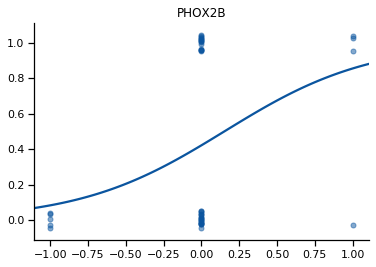

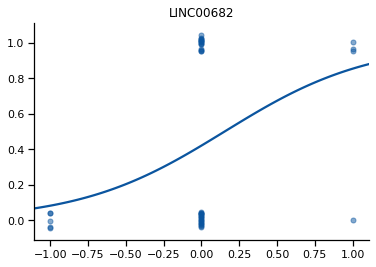

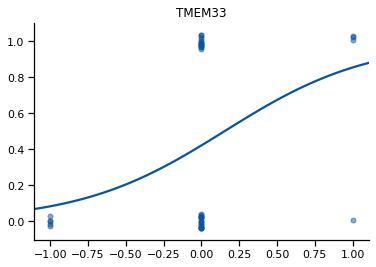

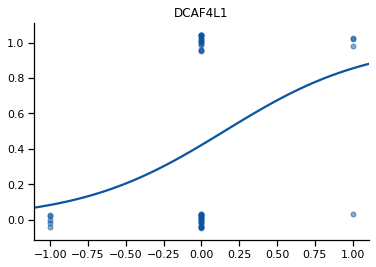

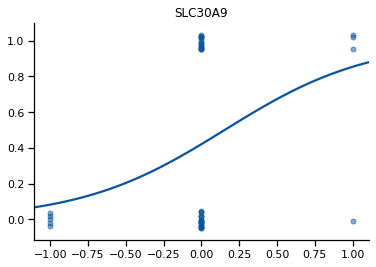

...

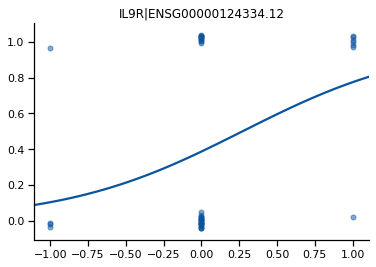

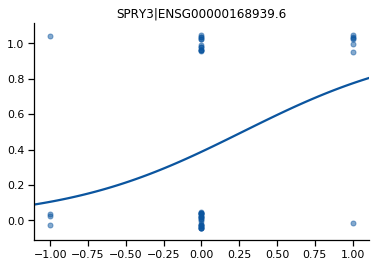

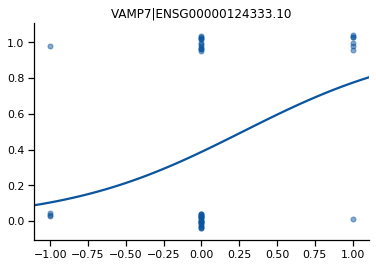

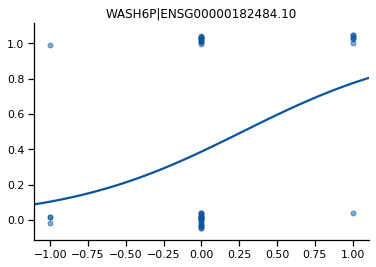

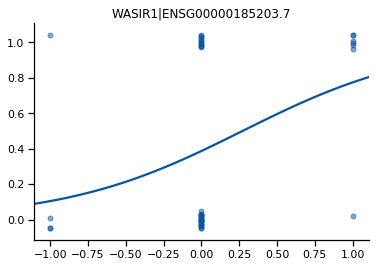

In [61]:
featurenames = data[top].iloc[:,1:].columns.tolist()
for i in range(len(featurenames)):
    sns.regplot(X_train[:,i+0].astype(float), y_train, color=sns.color_palette('Blues')[-1], ci=None, logistic=True, y_jitter=0.05, 
            scatter_kws={'s': 25, 'color': sns.color_palette('Blues')[-1], 'alpha': .5}).set_title(featurenames[i])
    sns.despine()
    plt.show()

# k-nearest neighbors (KNN)

In [14]:
from sklearn.model_selection import cross_val_score
from sklearn import neighbors

# use cross validation to find the best K
cv_scores = []
k_vals = []
 
for k in range(2, 17, 2):
    
    model = neighbors.KNeighborsClassifier(n_neighbors=k)
    
    scores = cross_val_score(model, X_train, y_train, cv=10, scoring='accuracy')
    score = scores.mean()
    
    print("k={0}, cv_score={1:.2f}".format(k, score * 100))
    
    cv_scores.append(score)
    k_vals.append(k)
    
# find best k
idx = np.argmax(cv_scores)
print("k={0} achieved highest accuracy of {1:.2f}".format(k_vals[idx], cv_scores[idx] * 100))

k=2, cv_score=69.50
k=4, cv_score=63.00
k=6, cv_score=70.00
k=8, cv_score=69.50
k=10, cv_score=74.00
k=12, cv_score=68.00
k=14, cv_score=61.50
k=16, cv_score=55.67
k=10 achieved highest accuracy of 74.00


No handles with labels found to put in legend.


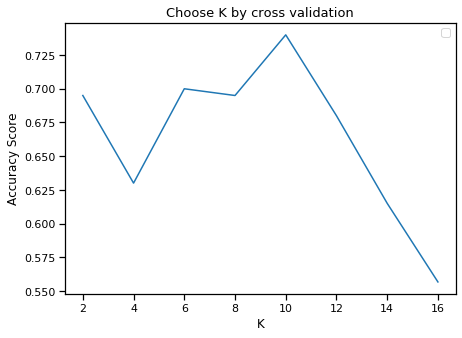

In [15]:
fig2, ax= plt.subplots(figsize=(7,5))
ax.plot(k_vals, cv_scores, color='#1F77B4')
ax.set_xlabel('K')
ax.set_ylabel('Accuracy Score')
ax.set_title('Choose K by cross validation', fontsize=13)
plt.legend()
plt.show()

In [16]:
from sklearn.model_selection import cross_val_score
from sklearn import neighbors
best_model_knn = neighbors.KNeighborsClassifier(n_neighbors = k_vals[idx])
best_model_knn.fit(X_train, y_train)

y_prob_knn= best_model_knn.predict_proba(X_val)
y_pred_knn= (y_prob_knn[:,1]>threshold).astype(int)

print( confusion_matrix(y_val, y_pred_knn) )

print(recall_score(y_val, y_pred_knn).round(3))
print(precision_score(y_val, y_pred_knn).round(3))

print(classification_report(y_val, y_pred_knn))

auc_knn=roc_auc_score(y_val, y_prob_knn[:,1]).round(3)
print(auc_knn)

[[4 3]
 [0 5]]
1.0
0.625
              precision    recall  f1-score   support

           0       1.00      0.57      0.73         7
           1       0.62      1.00      0.77         5

    accuracy                           0.75        12
   macro avg       0.81      0.79      0.75        12
weighted avg       0.84      0.75      0.74        12

0.829


In [17]:
print(y_val)
print(y_pred_knn)

[0 1 1 1 0 0 1 1 0 0 0 0]
[0 1 1 1 1 1 1 1 1 0 0 0]


#  Support Vector Machine (SVM)

In [18]:
from sklearn.model_selection import GridSearchCV
from sklearn import svm

# using gridsearchcv takes a very long time to run 
param_grid = {'C': [1, 1e1, 1e2, 1e3],
              'gamma': [0.00001, 0.0001, 0.001, 0.01 ], }

param_grid = {'kernel': ('linear','rbf')}
clf = GridSearchCV(svm.SVC(class_weight='balanced', probability=True,random_state=0), param_grid)
clf = clf.fit(X_train, y_train)

print("Best estimator found by grid search:")
print(clf.best_estimator_)

best_model_svm = clf.best_estimator_
best_model_svm.fit(X_train, y_train)


#print("Best estimator found by grid search:")
#print(clf.best_estimator_)

Best estimator found by grid search:
SVC(C=1.0, cache_size=200, class_weight='balanced', coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
    kernel='rbf', max_iter=-1, probability=True, random_state=0, shrinking=True,
    tol=0.001, verbose=False)


C:\Users\YL\Anaconda3\envs\py36_imu\lib\site-packages\sklearn\model_selection\_search.py:813: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


SVC(C=1.0, cache_size=200, class_weight='balanced', coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
    kernel='rbf', max_iter=-1, probability=True, random_state=0, shrinking=True,
    tol=0.001, verbose=False)

In [19]:
y_prob_svm= best_model_svm.predict_proba(X_val)
y_pred_svm = (y_prob_svm[:,1]>threshold).astype(int)

print(confusion_matrix(y_val, y_pred_svm))

print(recall_score(y_val, y_pred_svm).round(3))
print(precision_score(y_val, y_pred_svm).round(3))

print(classification_report(y_val, y_pred_svm))

auc_svm=roc_auc_score(y_val, y_prob_svm[:,1]).round(3)
print(auc_svm)

[[7 0]
 [3 2]]
0.4
1.0
              precision    recall  f1-score   support

           0       0.70      1.00      0.82         7
           1       1.00      0.40      0.57         5

    accuracy                           0.75        12
   macro avg       0.85      0.70      0.70        12
weighted avg       0.82      0.75      0.72        12

0.914


# Logistic Regression

In [20]:
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LogisticRegressionCV

# Logistic regression
logit = LogisticRegression(class_weight='balanced')
logit.fit(X_train, y_train)
print(logit)

# L-1 Regularised logistic regression
logit_l1 = LogisticRegressionCV(penalty='l1', solver='liblinear')
logit_l1.fit(X_train, y_train)
print(logit_l1)

# L-2 Regularised logistic regression
logit_l2 = LogisticRegressionCV(penalty='l2', class_weight='balanced')
logit_l2.fit(X_train, y_train)
print(logit_l2)

LogisticRegression(C=1.0, class_weight='balanced', dual=False,
                   fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                   max_iter=100, multi_class='warn', n_jobs=None, penalty='l2',
                   random_state=None, solver='warn', tol=0.0001, verbose=0,
                   warm_start=False)
LogisticRegressionCV(Cs=10, class_weight=None, cv='warn', dual=False,
                     fit_intercept=True, intercept_scaling=1.0, l1_ratios=None,
                     max_iter=100, multi_class='warn', n_jobs=None,
                     penalty='l1', random_state=None, refit=True, scoring=None,
                     solver='liblinear', tol=0.0001, verbose=0)
LogisticRegressionCV(Cs=10, class_weight='balanced', cv='warn', dual=False,
                     fit_intercept=True, intercept_scaling=1.0, l1_ratios=None,
                     max_iter=100, multi_class='warn', n_jobs=None,
                     penalty='l2', random_state=None, refit=True, scoring=None,
   

In [21]:
for mylogitmodel in [logit, logit_l1, logit_l2]:
    print("=======================")
    print(mylogitmodel)
    print("--------------")
    y_prob_lg = mylogitmodel.predict_proba(X_val)
    y_pred_lg =(y_prob_lg[:,1]>0.45).astype(int)
    print( confusion_matrix(y_val, y_pred_lg) )
    print(classification_report(y_val, y_pred_lg))
    auc_lg=roc_auc_score(y_val, y_prob_lg[:,1]).round(3)
    print("auc = {}".format(auc_lg))
    print("f1 score = {}".format(f1_score(y_val, y_pred_lg)))
    print(y_prob_lg)
    print(y_pred_lg)
    print(y_val)

LogisticRegression(C=1.0, class_weight='balanced', dual=False,
                   fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                   max_iter=100, multi_class='warn', n_jobs=None, penalty='l2',
                   random_state=None, solver='warn', tol=0.0001, verbose=0,
                   warm_start=False)
--------------
[[5 2]
 [1 4]]
              precision    recall  f1-score   support

           0       0.83      0.71      0.77         7
           1       0.67      0.80      0.73         5

    accuracy                           0.75        12
   macro avg       0.75      0.76      0.75        12
weighted avg       0.76      0.75      0.75        12

auc = 0.8
f1 score = 0.7272727272727272
[[9.99753465e-01 2.46534594e-04]
 [9.96346437e-01 3.65356340e-03]
 [5.15608852e-01 4.84391148e-01]
 [5.15608852e-01 4.84391148e-01]
 [5.06204817e-01 4.93795183e-01]
 [5.92554377e-01 4.07445623e-01]
 [2.18798368e-01 7.81201632e-01]
 [8.06651040e-02 9.19334896e-01]
 [5.1560

In [22]:
y_prob_l1= logit_l1.predict_proba(X_val)
y_pred_l1= (y_prob_l1[:,1]>threshold).astype(int)

print( confusion_matrix(y_val, y_pred_l1) )

print(recall_score(y_val, y_pred_l1).round(3))
print(precision_score(y_val, y_pred_l1).round(3))

print(classification_report(y_val, y_pred_l1))

auc_l1=roc_auc_score(y_val, y_prob_l1[:,1]).round(3)
print(auc_l1)

[[6 1]
 [3 2]]
0.4
0.667
              precision    recall  f1-score   support

           0       0.67      0.86      0.75         7
           1       0.67      0.40      0.50         5

    accuracy                           0.67        12
   macro avg       0.67      0.63      0.62        12
weighted avg       0.67      0.67      0.65        12

0.771


In [23]:
y_prob_l2= logit_l2.predict_proba(X_val)
y_pred_l2= (y_prob_l2[:,1]>threshold).astype(int)

print( confusion_matrix(y_val, y_pred_l2) )

print(recall_score(y_val, y_pred_l2).round(3))
print(precision_score(y_val, y_pred_l2).round(3))

print(classification_report(y_val, y_pred_l2))

auc_l2= 0.886
print(auc_l2)

[[5 2]
 [1 4]]
0.8
0.667
              precision    recall  f1-score   support

           0       0.83      0.71      0.77         7
           1       0.67      0.80      0.73         5

    accuracy                           0.75        12
   macro avg       0.75      0.76      0.75        12
weighted avg       0.76      0.75      0.75        12

0.886


# XGBoost

In [24]:
import xgboost as xgb

from numpy import loadtxt
from xgboost import XGBClassifier


In [25]:
clf_xgb = XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=1, max_delta_step=0, max_depth=7,
              min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)

clf_xgb.fit(X_train, y_train)


print(clf_xgb)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, learning_rate=1,
              max_delta_step=0, max_depth=7, min_child_weight=1, missing=None,
              n_estimators=100, n_jobs=1, nthread=None,
              objective='binary:logistic', random_state=0, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=1, seed=None, silent=None,
              subsample=1, verbosity=1)


In [26]:
# make predictions for test data
y_pred = clf_xgb.predict(X_val)
predictions = [round(value) for value in y_pred]


# evaluate predictions
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(y_val, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))


Accuracy: 66.67%


In [27]:
y_prob_xgb = clf_xgb.predict_proba(X_val)
y_pred_xgb = (y_prob_xgb[:,1:]>0.0).astype(int)

print(confusion_matrix(y_val, predictions))
print(classification_report(y_val, predictions))

[[7 0]
 [4 1]]
              precision    recall  f1-score   support

           0       0.64      1.00      0.78         7
           1       1.00      0.20      0.33         5

    accuracy                           0.67        12
   macro avg       0.82      0.60      0.56        12
weighted avg       0.79      0.67      0.59        12



In [28]:
# make predictions for test data
y_pred = clf_xgb.predict(X_val)
predictions = [round(value) for value in y_pred]


# evaluate predictions
from sklearn.metrics import accuracy_score
accuracy = accuracy_score(y_val, predictions)
print("Accuracy: %.2f%%" % (accuracy * 100.0))



Accuracy: 66.67%


# Define bootstrapping function

In [29]:
def model_eval(bestmodel,num_iter=10):

    listf1scores = []
    listprecision = []
    listrecall = []
    listaccuracy = []
    listauc = []
    listrownames = []
    numiterations = 10

    for i in range(numiterations):
        listrownames.append(i)
        X_train,X_val,y_train,y_val = train_test_split(X, y,train_size=0.8, random_state=i,stratify=y)
        bestmodel.fit(X_train, y_train)
        y_pred_prob = bestmodel.predict_proba(X_val)
        y_pred =(y_pred_prob[:,1]>threshold).astype(int)
        listf1scores.append(f1_score(y_val, y_pred).round(4))
        listaccuracy.append(accuracy_score(y_val, y_pred).round(4))
        listprecision.append(precision_score(y_val, y_pred).round(4))
        listrecall.append(recall_score(y_val, y_pred).round(4))
        listauc.append(roc_auc_score(y_val, y_pred_prob[:,1]).round(4))

    listf1scores.append(np.mean(listf1scores).round(4))
    listaccuracy.append(np.mean(listaccuracy).round(4))
    listprecision.append(np.mean(listprecision).round(4))
    listrecall.append(np.mean(listrecall).round(4))
    listauc.append(np.mean(listauc).round(4))
    listrownames.append("Average")
    df_results = pd.DataFrame(columns=["Random state","F1 Score","Accuracy","Precision","Recall"])
    df_results["Random state"] = listrownames # [1,2,3,4,5,6,7,8,9,10,"Average"]
    df_results["F1 Score"] = listf1scores
    df_results["Accuracy"] = listaccuracy
    df_results["Precision"] = listprecision
    df_results["Recall"] = listrecall
    df_results["AUC"] = listauc
    
    return df_results

# Bootstrapping of Logistic Regression 

In [30]:
model_eval(logit,num_iter=10)

,Random state,F1 Score,Accuracy,Precision,Recall,AUC
0,0,0.7273,0.7500,0.6667,0.80,0.8000
1,1,0.6667,0.6667,0.5714,0.80,0.7143
2,2,0.6667,0.6667,0.5714,0.80,0.7857
3,3,0.0000,0.5000,0.0000,0.00,0.6857
4,4,0.6000,0.6667,0.6000,0.60,0.7857
5,5,0.2500,0.5000,0.3333,0.20,0.6000
6,6,0.6667,0.6667,0.5714,0.80,0.8857
7,7,0.5000,0.5000,0.4286,0.60,0.4286
8,8,0.5455,0.5833,0.5000,0.60,0.6571
9,9,0.8333,0.8333,0.7143,1.00,0.8286


# Bootstrapping of lg_l2

In [31]:
model_eval(logit_l2,num_iter=10)

,Random state,F1 Score,Accuracy,Precision,Recall,AUC
0,0,0.7273,0.7500,0.6667,0.80,0.8857
1,1,0.7692,0.7500,0.6250,1.00,0.9143
2,2,0.6667,0.6667,0.5714,0.80,0.8143
3,3,0.7692,0.7500,0.6250,1.00,0.7429
4,4,0.7273,0.7500,0.6667,0.80,0.8714
5,5,0.7692,0.7500,0.6250,1.00,0.9143
6,6,0.7692,0.7500,0.6250,1.00,0.9143
7,7,0.8333,0.8333,0.7143,1.00,0.9714
8,8,0.7692,0.7500,0.6250,1.00,0.9714
9,9,0.7143,0.6667,0.5556,1.00,0.8286


* In conclusion, the best model to use is **L2 Regularised Logistic Regression** with parameters Cs=10, penalty= 'l2'.
* For random state 2, the results are realtively lower as there is high possibility that subjects representing rare combinations of gene signatures did not appear in the training data.
* For further analysis, use all data if possible, or at least train set where random state = 0 as it represents maximum combinations of gene signatures where subjects respond to Gemcitabine, given the current dataset available.

## BST of logit_l1

In [32]:
model_eval(logit_l1,num_iter=10)

,Random state,F1 Score,Accuracy,Precision,Recall,AUC
0,0,0.5000,0.6667,0.6667,0.4,0.7714
1,1,0.5714,0.5000,0.4444,0.8,0.6286
2,2,0.6667,0.6667,0.5714,0.8,0.7857
3,3,0.0000,0.5000,0.0000,0.0,0.6571
4,4,0.3333,0.6667,1.0000,0.2,0.6857
5,5,0.3333,0.6667,1.0000,0.2,0.6857
6,6,0.5000,0.5000,0.4286,0.6,0.6000
7,7,0.1818,0.2500,0.1667,0.2,0.2000
8,8,0.2857,0.5833,0.5000,0.2,0.7143
9,9,0.6667,0.7500,0.7500,0.6,0.8429


## BST of KNN

In [33]:
model_eval(best_model_knn,num_iter=10)

,Random state,F1 Score,Accuracy,Precision,Recall,AUC
0,0,0.7692,0.7500,0.6250,1.00,0.8286
1,1,0.6667,0.5833,0.5000,1.00,0.7714
2,2,0.7143,0.6667,0.5556,1.00,0.7286
3,3,0.2857,0.5833,0.5000,0.20,0.5714
4,4,0.8333,0.8333,0.7143,1.00,0.8857
5,5,0.3333,0.6667,1.0000,0.20,0.7714
6,6,0.6667,0.5833,0.5000,1.00,0.8286
7,7,0.7143,0.6667,0.5556,1.00,0.7143
8,8,0.2857,0.5833,0.5000,0.20,0.6000
9,9,0.8333,0.8333,0.7143,1.00,0.8286


## BST of SVM

In [34]:
model_eval(best_model_svm,num_iter=10)

,Random state,F1 Score,Accuracy,Precision,Recall,AUC
0,0,0.5714,0.7500,1.0000,0.40,0.9143
1,1,0.7692,0.7500,0.6250,1.00,0.8571
2,2,0.7500,0.8333,1.0000,0.60,0.8429
3,3,0.2857,0.5833,0.5000,0.20,0.7429
4,4,0.7273,0.7500,0.6667,0.80,0.9286
5,5,0.7692,0.7500,0.6250,1.00,0.9143
6,6,0.7692,0.7500,0.6250,1.00,1.0000
7,7,0.3333,0.6667,1.0000,0.20,0.9714
8,8,0.3333,0.6667,1.0000,0.20,0.9714
9,9,0.8333,0.8333,0.7143,1.00,0.8286


## BST of XGB

In [35]:
model_eval(clf_xgb,num_iter=10)

,Random state,F1 Score,Accuracy,Precision,Recall,AUC
0,0,0.3333,0.6667,1.0000,0.20,0.8857
1,1,0.5455,0.5833,0.5000,0.60,0.6571
2,2,0.7692,0.7500,0.6250,1.00,0.7857
3,3,0.6154,0.5833,0.5000,0.80,0.5571
4,4,0.0000,0.5833,0.0000,0.00,0.6000
5,5,0.7143,0.6667,0.5556,1.00,0.7714
6,6,0.6667,0.6667,0.5714,0.80,0.8286
7,7,0.4615,0.4167,0.3750,0.60,0.5714
8,8,0.6154,0.5833,0.5000,0.80,0.7714
9,9,0.6667,0.6667,0.5714,0.80,0.7714


# Best Prediction Model- L2 Regularised Logistic Regression

In [36]:
bestlogitmodel =LogisticRegressionCV(Cs=10, class_weight='balanced', cv='warn', dual=False,
                     fit_intercept=True, intercept_scaling=1.0, l1_ratios=None,
                     max_iter=100, multi_class='warn', n_jobs=None,
                     penalty='l2', random_state=None, refit=True, scoring=None,
                     solver='lbfgs', tol=0.0001, verbose=0)
X_train_final,X_val_final,y_train_final,y_val_final = train_test_split(X, y,train_size=0.8, random_state=0,stratify=y)
bestlogitmodel.fit(X_train_final, y_train_final)

LogisticRegressionCV(Cs=10, class_weight='balanced', cv='warn', dual=False,
                     fit_intercept=True, intercept_scaling=1.0, l1_ratios=None,
                     max_iter=100, multi_class='warn', n_jobs=None,
                     penalty='l2', random_state=None, refit=True, scoring=None,
                     solver='lbfgs', tol=0.0001, verbose=0)

In [37]:
numiterations = 10
listf1scores = []
listprecision = []
listrecall = []
listaccuracy = []
listauc = []
listrownames = []
nsamples = len(X)
totaltosample = int(0.2*(nsamples))
df_final = data[top]
for i in range(numiterations):
    listrownames.append(i+1)
    df_boot = df_final.iloc[np.random.randint(nsamples, size=totaltosample),:]
    X_boot = df_boot.iloc[:,1:].values
    y_val_final = df_boot.iloc[:,0].values
    y_pred_prob = bestlogitmodel.predict_proba(X_boot)
    y_pred =(y_pred_prob[:,1]>threshold).astype(int)
    listf1scores.append(f1_score(y_val_final, y_pred).round(4))
    listaccuracy.append(accuracy_score(y_val_final, y_pred).round(4))
    listprecision.append(precision_score(y_val_final, y_pred).round(4))
    listrecall.append(recall_score(y_val_final, y_pred).round(4))
    listauc.append(roc_auc_score(y_val_final, y_pred_prob[:,1]).round(4))
    
listf1scores.append(np.mean(listf1scores).round(4))
listaccuracy.append(np.mean(listaccuracy).round(4))
listprecision.append(np.mean(listprecision).round(4))
listrecall.append(np.mean(listrecall).round(4))
listauc.append(np.mean(listauc).round(4))
listrownames.append("Average")
df_results = pd.DataFrame(columns=["Iteration","F1 Score","Accuracy","Precision","Recall"])
df_results["Iteration"] = listrownames # [1,2,3,4,5,6,7,8,9,10,"Average"]
df_results["F1 Score"] = listf1scores
df_results["Accuracy"] = listaccuracy
df_results["Precision"] = listprecision
df_results["Recall"] = listrecall
df_results["AUC"] = listauc

# display the results table
df_results

,Iteration,F1 Score,Accuracy,Precision,Recall,AUC
0,1,0.8889,0.9091,0.8000,1.0000,1.0000
1,2,1.0000,1.0000,1.0000,1.0000,1.0000
2,3,0.8000,0.8182,0.6667,1.0000,0.7143
3,4,0.5000,0.6364,0.3333,1.0000,0.9167
4,5,0.5000,0.6364,0.3333,1.0000,0.9167
5,6,0.8333,0.8182,0.8333,0.8333,0.7333
6,7,0.8000,0.8182,0.6667,1.0000,0.9643
7,8,0.8333,0.8182,0.7143,1.0000,0.9333
8,9,0.8889,0.9091,0.8000,1.0000,1.0000
9,10,0.7500,0.8182,0.6000,1.0000,1.0000


# Further analysis of why the average F1 Score is less than 0.8 via K-Means Clustering

In [38]:
from kneed import KneeLocator
from sklearn.cluster import KMeans, MiniBatchKMeans
import matplotlib.colors as colours
from itertools import cycle
from IPython.display import display

In [39]:
df_analysis = pd.read_csv("900 amp and del from fisher exact.csv")
var_response = "Gemcitabine Response"
listfeatures = list(df_analysis.columns)
listfeatures.remove(var_response)
# print(df_analysis.shape)
# print(listfeatures)

In [40]:
df_analysis[var_response] = df_analysis[var_response].astype(int)
df_analysis.head()

,Gemcitabine Response,PHOX2B,LINC00682,TMEM33,DCAF4L1,SLC30A9,BEND4,SHISA3,ATP8A1,GRXCR1,RN7SKP82,COX7B2,GABRA4,GABRB1,snoU13|ENSG00000238301.1,COMMD8,ATP10D,CORIN,RN7SKP215,NFXL1,NIPAL1,CNGA1,TXK,CWH43,FRYL,OCIAD1,OCIAD2,SLAIN2,SLC10A4,TEC,ZAR1,KIT,RN7SL205P,SNORA70|ENSG00000252014.1,HHIP,ANAPC10,RN7SKP235,ABCE1,OTUD4,SMAD1,MMAA,C4orf51,ZNF827,LSM6,SLC10A7,POU4F2,TTC29,MIR548G,EDNRA,TMEM184C,PRMT10,ARHGAP10,RNA5SP165,MIR4799,RN7SL254P,DCLK2,LRBA,MAB21L2,RNA5SP168,RPS3A,SH3D19,SNORD73,SNORD73A,PRSS48,FAM160A1,RN7SKP35,PET112,RNA5SP169,RN7SL446P,FBXW7,MIR3140,MIR4453,TMEM154,TIGD4,ARFIP1,FHDC1,TRIM2,MND1,RN7SL419P,KIAA0922,TLR2,RNF175,SFRP2,DCHS2,PLRG1,FGB,FGA,FGG,LRAT,RBM46,NPY2R,MAP9,GUCY1A3,GUCY1B3,ASIC5,TDO2,CTSO,B4GALNT3,CCDC77,FAM138D,IQSEC3,KDM5A,NINJ2,RNU4ATAC16P,SLC6A12,SLC6A13,WNK1,RAD52,ERC1,RN7SL852P,ADIPOR2,FBXL14,LINC00942,MIR3649,WNT5B,CACNA2D4,LRTM2,LINC00940,DCP1B,CACNA1C,CBX3P4,FKBP4,ITFG2,NRIP2,FOXM1,RHNO1,TULP3,TEAD4,TSPAN9,PRMT8,EFCAB4B,PARP11,CCND2,CD4,MANSC1,LOH12CR2,LOH12CR1,DUSP16,CREBL2,GPR19,CDKN1B,APOLD1,MIR613,DDX47,GPRC5A,GPRC5D,GSG1,HEBP1,HTR7P1,KIAA1467,MIR614,SNORD88,H2AFJ,HIST4H4,WBP11,C12orf60,SMCO3,ART4,MGP,ERP27,ARHGDIB,PDE6H,RERG,BCAT1,C12orf77,LRMP,CASC1,LYRM5,KRAS,RASSF8,BHLHE41,SSPN,ITPR2,RNA5SP354,ASUN,FGFR1OP2,TM7SF3,MED21,C12orf71,STK38L,MANSC4,KLHL42,RN7SKP15,PTHLH,KIF21A,ABCD2,C12orf40,SLC2A13,SNORA22|ENSG00000199571.1,LRRK2,MUC19,CNTN1,PDZRN4,RNA5SP360,GXYLT1,YAF2,PPHLN1,RN7SL10P,ZCRB1,SNORA74|ENSG00000252917.1,PRICKLE1,ADAMTS20,PUS7L,IRAK4,TWF1,TMEM117,NELL2,DBX2,RNA5SP361,PLEKHA8P1,ANO6,ARID2,RN7SL246P,SCAF11,SLC38A1,SLC38A2,SLC38A4,AMIGO2,PCED1B,MIR4698,SNORA64|ENSG00000199566.1,MIR4494,RPAP3,ENDOU,RAPGEF3,SLC48A1,HDAC7,VDR,TMEM106C,COL2A1,SENP1,PFKM,ASB8,C12orf68,DKFZP779L1853,OR10AD1,H1FNT,ZNF641,ANP32D,C12orf54,OR8S1,LALBA,KANSL2,SNORA34,SNORA2A,SNORA2B,CCNT1,LINC00935,OR6C65,OR6C76,...,MIR450B,MIR503HG,MIR542,MIR503,LINC00629,PLAC1,FAM122B,FAM122C,MOSPD1,SMIM10,FAM127C,FAM127A,FAM127B,LINC00087,LINC00633,CT45A1,CT45A2,CT45A3,CT45A4,CT45A5,CT45A6,CXorf48,DDX26B,LINC00086,RNA5SP515,SAGE1,ZNF449,ZNF75D,MMGT1,SLC9A6,snoU13|ENSG00000239080.1,FHL1,MAP7D3,GPR112,BRS3,HTATSF1,VGLL1,MIR934,LINC00892,CD40LG,ARHGEF6,RBMX,SNORD61|ENSG00000206979.1,GPR101,ZIC3,RN7SL325P,RN7SKP31,FGF13,MIR504,F9,MCF2,ATP11C,CXorf66,MIR505,RN7SL727P,RNU6ATAC23P,SNORA18|ENSG00000252719.1,snoU13|ENSG00000238485.1,SOX3,LINC00632,CDR1,MIR320D2,SPANXB1,SPANXB2,LDOC1,MAGEC1,MAGEC3,SPANXA1,SPANXA2,SPANXC,SPANXD,MAGEC2,RNA5SP516,snoU13|ENSG00000239188.1,SPANXN4,RN7SKP81,RN7SKP149,SPANXN3,SLITRK4,SPANXN2,UBE2NL,RN7SKP189,SPANXN1,SLITRK2,TMEM257,MIR888,MIR890,MIR892A,MIR892B,MIR891B,MIR891A,RNA5SP517,CXorf51A,CXorf51B,MIR513C,MIR513B,MIR513A1,MIR513A2,MIR506,MIR507,MIR508,MIR514B,MIR510,MIR514A1,MIR514A2,MIR514A3,FMR1,FMR1NB,AFF2,RN7SKP267,IDS,LINC00893,CXorf40A,CXorf40B,HSFX1,HSFX2,LINC00894,MAGEA11,MAGEA8,MAGEA9,MAGEA9B,TMEM185A,MIR2114,MAMLD1,MTM1,MTMR1,CD99L2,U3|ENSG00000253009.1,HMGB3,MIR4330,GPR50,VMA21,PASD1,PRRG3,FATE1,CNGA2,MAGEA4,GABRE,MIR224,MIR452,MAGEA10,GABRA3,MIR767,GABRQ,CETN2,CSAG1,CSAG2,CSAG3,CSAG4,MAGEA1,MAGEA12,MAGEA2,MAGEA2B,MAGEA3,MAGEA6,NSDHL,PNMA3,PNMA5,PNMA6A,PNMA6B,PNMA6C,PNMA6D,RN7SL190P,RN7SL667P,ZFP92,ZNF185,ZNF275,snoU13|ENSG00000239037.1,HAUS7,TREX2,BGN,ATP2B3,FAM58A,DUSP9,RN7SL687P,PNCK,SLC6A8,BCAP31,ABCD1,PLXNB3,IDH3G,SRPK3,SSR4,PDZD4,SNORD36|ENSG00000251846.1,L1CAM,LCA10,AVPR2,ARHGAP4,NAA10,RENBP,HCFC1,TMEM187,IRAK1,MECP2,MIR718,OPN1LW,OPN1MW,OPN1MW2,TEX28,TEX28P1,TEX28P2,TKTL1,EMD,FLNA,RPL10,SNORA70|ENSG00000207165.1,DNASE1L1,TAZ,ATP6AP1,FAM50A,GDI1,PLXNA3,LAGE3,UBL4A,SLC10A3,RN7SL697P,RN7SL742P,FAM3A,G6PD,IKBKG,BRCC3,CLIC2,CMC4,CTAG1A,CTAG1B,CTAG2,DKC1,F8,F8A1,F8A2,F8A3,FUNDC2,GAB3,H2AFB1,H2AFB2,H2AFB3,MPP1,MTCP1,RAB39B,SMIM9,SNORA36A,SNORA56,TMLHE,VBP1,IL9R|ENSG00000124334.12,SPRY3|ENSG00000168939.6,VAMP7|ENSG00000124333.10,WASH6P|ENSG00000182484.10,WASIR1|ENSG00000185203.7
0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1

In [41]:
seed = 0
X = df_analysis[listfeatures].values
print(X.shape)

y = df_analysis[var_response].values
print(y.shape)

# use optimum data representation for clustering
X_train,X_val,y_train,y_val = train_test_split(X, y,train_size=0.8, random_state=seed,stratify=y)

(57, 987)
(57,)


In [42]:
sumofsquareddistances = []
K = range(2,30)
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(X_train)
    sumofsquareddistances.append(km.inertia_)

10


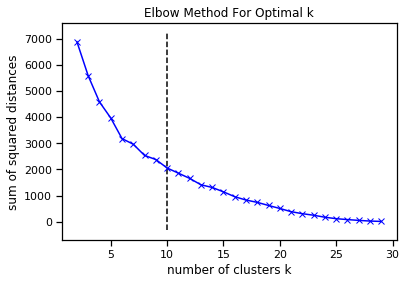

In [43]:
kn = KneeLocator(K, sumofsquareddistances, curve='convex', direction='decreasing')
optimumclusters = kn.knee
print(optimumclusters)

plt.xlabel('number of clusters k')
plt.ylabel('sum of squared distances')
plt.title('Elbow Method For Optimal k')
plt.plot(K, sumofsquareddistances, 'bx-')
plt.vlines(kn.knee, plt.ylim()[0], plt.ylim()[1], linestyles='dashed')
plt.show();

In [44]:
clustermodel = MiniBatchKMeans(init="k-means++", n_clusters=optimumclusters, batch_size=optimumclusters, max_no_improvement=10, verbose=0)
clustermodel

MiniBatchKMeans(batch_size=10, compute_labels=True, init='k-means++',
                init_size=None, max_iter=100, max_no_improvement=10,
                n_clusters=10, n_init=3, random_state=None,
                reassignment_ratio=0.01, tol=0.0, verbose=0)

In [45]:
clustermodel.fit(X)
predlabels = clustermodel.labels_

In [46]:
centroids = clustermodel.cluster_centers_
colors_ = cycle(colours.cnames.keys())

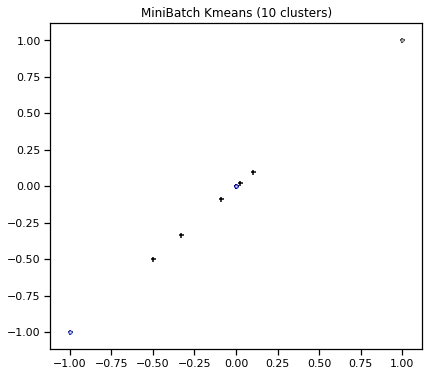

In [47]:
currmodelname = "MiniBatch Kmeans"
fig = plt.figure(figsize=(6,6))
fig.subplots_adjust(left=0.04)
ax = fig.add_subplot(1, 1, 1)
for this_centroid, k, col in zip(centroids, range(optimumclusters), colors_):
    mask = predlabels == k
    ax.scatter(X[mask,0], X[mask,1], c='w', edgecolor=col, marker='.', alpha=0.5)
    ax.scatter(this_centroid[0], this_centroid[1], marker='+', c='k', s=25)
ax.set_autoscaley_on(False)
ax.set_title("{} ({} clusters)".format("MiniBatch Kmeans", optimumclusters))
plt.show();

From the above clustering plot, it is evident the subjects are hard to cluster in terms of similar gene signatures. Going forward, more data would improve the clustering and understanding process.

# Determination of clusters' identidies

In [48]:
df_analysis["cluster"] = predlabels


In [49]:
for currcluster in np.unique(predlabels):
    print("CLUSTER {} ===============================".format(currcluster))
    display(df_analysis[df_analysis["cluster"] == currcluster])

CLUSTER 0 ===============================


,Gemcitabine Response,PHOX2B,LINC00682,TMEM33,DCAF4L1,SLC30A9,BEND4,SHISA3,ATP8A1,GRXCR1,RN7SKP82,COX7B2,GABRA4,GABRB1,snoU13|ENSG00000238301.1,COMMD8,ATP10D,CORIN,RN7SKP215,NFXL1,NIPAL1,CNGA1,TXK,CWH43,FRYL,OCIAD1,OCIAD2,SLAIN2,SLC10A4,TEC,ZAR1,KIT,RN7SL205P,SNORA70|ENSG00000252014.1,HHIP,ANAPC10,RN7SKP235,ABCE1,OTUD4,SMAD1,MMAA,C4orf51,ZNF827,LSM6,SLC10A7,POU4F2,TTC29,MIR548G,EDNRA,TMEM184C,PRMT10,ARHGAP10,RNA5SP165,MIR4799,RN7SL254P,DCLK2,LRBA,MAB21L2,RNA5SP168,RPS3A,SH3D19,SNORD73,SNORD73A,PRSS48,FAM160A1,RN7SKP35,PET112,RNA5SP169,RN7SL446P,FBXW7,MIR3140,MIR4453,TMEM154,TIGD4,ARFIP1,FHDC1,TRIM2,MND1,RN7SL419P,KIAA0922,TLR2,RNF175,SFRP2,DCHS2,PLRG1,FGB,FGA,FGG,LRAT,RBM46,NPY2R,MAP9,GUCY1A3,GUCY1B3,ASIC5,TDO2,CTSO,B4GALNT3,CCDC77,FAM138D,IQSEC3,KDM5A,NINJ2,RNU4ATAC16P,SLC6A12,SLC6A13,WNK1,RAD52,ERC1,RN7SL852P,ADIPOR2,FBXL14,LINC00942,MIR3649,WNT5B,CACNA2D4,LRTM2,LINC00940,DCP1B,CACNA1C,CBX3P4,FKBP4,ITFG2,NRIP2,FOXM1,RHNO1,TULP3,TEAD4,TSPAN9,PRMT8,EFCAB4B,PARP11,CCND2,CD4,MANSC1,LOH12CR2,LOH12CR1,DUSP16,CREBL2,GPR19,CDKN1B,APOLD1,MIR613,DDX47,GPRC5A,GPRC5D,GSG1,HEBP1,HTR7P1,KIAA1467,MIR614,SNORD88,H2AFJ,HIST4H4,WBP11,C12orf60,SMCO3,ART4,MGP,ERP27,ARHGDIB,PDE6H,RERG,BCAT1,C12orf77,LRMP,CASC1,LYRM5,KRAS,RASSF8,BHLHE41,SSPN,ITPR2,RNA5SP354,ASUN,FGFR1OP2,TM7SF3,MED21,C12orf71,STK38L,MANSC4,KLHL42,RN7SKP15,PTHLH,KIF21A,ABCD2,C12orf40,SLC2A13,SNORA22|ENSG00000199571.1,LRRK2,MUC19,CNTN1,PDZRN4,RNA5SP360,GXYLT1,YAF2,PPHLN1,RN7SL10P,ZCRB1,SNORA74|ENSG00000252917.1,PRICKLE1,ADAMTS20,PUS7L,IRAK4,TWF1,TMEM117,NELL2,DBX2,RNA5SP361,PLEKHA8P1,ANO6,ARID2,RN7SL246P,SCAF11,SLC38A1,SLC38A2,SLC38A4,AMIGO2,PCED1B,MIR4698,SNORA64|ENSG00000199566.1,MIR4494,RPAP3,ENDOU,RAPGEF3,SLC48A1,HDAC7,VDR,TMEM106C,COL2A1,SENP1,PFKM,ASB8,C12orf68,DKFZP779L1853,OR10AD1,H1FNT,ZNF641,ANP32D,C12orf54,OR8S1,LALBA,KANSL2,SNORA34,SNORA2A,SNORA2B,CCNT1,LINC00935,OR6C65,OR6C76,...,MIR503HG,MIR542,MIR503,LINC00629,PLAC1,FAM122B,FAM122C,MOSPD1,SMIM10,FAM127C,FAM127A,FAM127B,LINC00087,LINC00633,CT45A1,CT45A2,CT45A3,CT45A4,CT45A5,CT45A6,CXorf48,DDX26B,LINC00086,RNA5SP515,SAGE1,ZNF449,ZNF75D,MMGT1,SLC9A6,snoU13|ENSG00000239080.1,FHL1,MAP7D3,GPR112,BRS3,HTATSF1,VGLL1,MIR934,LINC00892,CD40LG,ARHGEF6,RBMX,SNORD61|ENSG00000206979.1,GPR101,ZIC3,RN7SL325P,RN7SKP31,FGF13,MIR504,F9,MCF2,ATP11C,CXorf66,MIR505,RN7SL727P,RNU6ATAC23P,SNORA18|ENSG00000252719.1,snoU13|ENSG00000238485.1,SOX3,LINC00632,CDR1,MIR320D2,SPANXB1,SPANXB2,LDOC1,MAGEC1,MAGEC3,SPANXA1,SPANXA2,SPANXC,SPANXD,MAGEC2,RNA5SP516,snoU13|ENSG00000239188.1,SPANXN4,RN7SKP81,RN7SKP149,SPANXN3,SLITRK4,SPANXN2,UBE2NL,RN7SKP189,SPANXN1,SLITRK2,TMEM257,MIR888,MIR890,MIR892A,MIR892B,MIR891B,MIR891A,RNA5SP517,CXorf51A,CXorf51B,MIR513C,MIR513B,MIR513A1,MIR513A2,MIR506,MIR507,MIR508,MIR514B,MIR510,MIR514A1,MIR514A2,MIR514A3,FMR1,FMR1NB,AFF2,RN7SKP267,IDS,LINC00893,CXorf40A,CXorf40B,HSFX1,HSFX2,LINC00894,MAGEA11,MAGEA8,MAGEA9,MAGEA9B,TMEM185A,MIR2114,MAMLD1,MTM1,MTMR1,CD99L2,U3|ENSG00000253009.1,HMGB3,MIR4330,GPR50,VMA21,PASD1,PRRG3,FATE1,CNGA2,MAGEA4,GABRE,MIR224,MIR452,MAGEA10,GABRA3,MIR767,GABRQ,CETN2,CSAG1,CSAG2,CSAG3,CSAG4,MAGEA1,MAGEA12,MAGEA2,MAGEA2B,MAGEA3,MAGEA6,NSDHL,PNMA3,PNMA5,PNMA6A,PNMA6B,PNMA6C,PNMA6D,RN7SL190P,RN7SL667P,ZFP92,ZNF185,ZNF275,snoU13|ENSG00000239037.1,HAUS7,TREX2,BGN,ATP2B3,FAM58A,DUSP9,RN7SL687P,PNCK,SLC6A8,BCAP31,ABCD1,PLXNB3,IDH3G,SRPK3,SSR4,PDZD4,SNORD36|ENSG00000251846.1,L1CAM,LCA10,AVPR2,ARHGAP4,NAA10,RENBP,HCFC1,TMEM187,IRAK1,MECP2,MIR718,OPN1LW,OPN1MW,OPN1MW2,TEX28,TEX28P1,TEX28P2,TKTL1,EMD,FLNA,RPL10,SNORA70|ENSG00000207165.1,DNASE1L1,TAZ,ATP6AP1,FAM50A,GDI1,PLXNA3,LAGE3,UBL4A,SLC10A3,RN7SL697P,RN7SL742P,FAM3A,G6PD,IKBKG,BRCC3,CLIC2,CMC4,CTAG1A,CTAG1B,CTAG2,DKC1,F8,F8A1,F8A2,F8A3,FUNDC2,GAB3,H2AFB1,H2AFB2,H2AFB3,MPP1,MTCP1,RAB39B,SMIM9,SNORA36A,SNORA56,TMLHE,VBP1,IL9R|ENSG00000124334.12,SPRY3|ENSG00000168939.6,VAMP7|ENSG00000124333.10,WASH6P|ENSG00000182484.10,WASIR1|ENSG00000185203.7,cluster
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

CLUSTER 1 ===============================


,Gemcitabine Response,PHOX2B,LINC00682,TMEM33,DCAF4L1,SLC30A9,BEND4,SHISA3,ATP8A1,GRXCR1,RN7SKP82,COX7B2,GABRA4,GABRB1,snoU13|ENSG00000238301.1,COMMD8,ATP10D,CORIN,RN7SKP215,NFXL1,NIPAL1,CNGA1,TXK,CWH43,FRYL,OCIAD1,OCIAD2,SLAIN2,SLC10A4,TEC,ZAR1,KIT,RN7SL205P,SNORA70|ENSG00000252014.1,HHIP,ANAPC10,RN7SKP235,ABCE1,OTUD4,SMAD1,MMAA,C4orf51,ZNF827,LSM6,SLC10A7,POU4F2,TTC29,MIR548G,EDNRA,TMEM184C,PRMT10,ARHGAP10,RNA5SP165,MIR4799,RN7SL254P,DCLK2,LRBA,MAB21L2,RNA5SP168,RPS3A,SH3D19,SNORD73,SNORD73A,PRSS48,FAM160A1,RN7SKP35,PET112,RNA5SP169,RN7SL446P,FBXW7,MIR3140,MIR4453,TMEM154,TIGD4,ARFIP1,FHDC1,TRIM2,MND1,RN7SL419P,KIAA0922,TLR2,RNF175,SFRP2,DCHS2,PLRG1,FGB,FGA,FGG,LRAT,RBM46,NPY2R,MAP9,GUCY1A3,GUCY1B3,ASIC5,TDO2,CTSO,B4GALNT3,CCDC77,FAM138D,IQSEC3,KDM5A,NINJ2,RNU4ATAC16P,SLC6A12,SLC6A13,WNK1,RAD52,ERC1,RN7SL852P,ADIPOR2,FBXL14,LINC00942,MIR3649,WNT5B,CACNA2D4,LRTM2,LINC00940,DCP1B,CACNA1C,CBX3P4,FKBP4,ITFG2,NRIP2,FOXM1,RHNO1,TULP3,TEAD4,TSPAN9,PRMT8,EFCAB4B,PARP11,CCND2,CD4,MANSC1,LOH12CR2,LOH12CR1,DUSP16,CREBL2,GPR19,CDKN1B,APOLD1,MIR613,DDX47,GPRC5A,GPRC5D,GSG1,HEBP1,HTR7P1,KIAA1467,MIR614,SNORD88,H2AFJ,HIST4H4,WBP11,C12orf60,SMCO3,ART4,MGP,ERP27,ARHGDIB,PDE6H,RERG,BCAT1,C12orf77,LRMP,CASC1,LYRM5,KRAS,RASSF8,BHLHE41,SSPN,ITPR2,RNA5SP354,ASUN,FGFR1OP2,TM7SF3,MED21,C12orf71,STK38L,MANSC4,KLHL42,RN7SKP15,PTHLH,KIF21A,ABCD2,C12orf40,SLC2A13,SNORA22|ENSG00000199571.1,LRRK2,MUC19,CNTN1,PDZRN4,RNA5SP360,GXYLT1,YAF2,PPHLN1,RN7SL10P,ZCRB1,SNORA74|ENSG00000252917.1,PRICKLE1,ADAMTS20,PUS7L,IRAK4,TWF1,TMEM117,NELL2,DBX2,RNA5SP361,PLEKHA8P1,ANO6,ARID2,RN7SL246P,SCAF11,SLC38A1,SLC38A2,SLC38A4,AMIGO2,PCED1B,MIR4698,SNORA64|ENSG00000199566.1,MIR4494,RPAP3,ENDOU,RAPGEF3,SLC48A1,HDAC7,VDR,TMEM106C,COL2A1,SENP1,PFKM,ASB8,C12orf68,DKFZP779L1853,OR10AD1,H1FNT,ZNF641,ANP32D,C12orf54,OR8S1,LALBA,KANSL2,SNORA34,SNORA2A,SNORA2B,CCNT1,LINC00935,OR6C65,OR6C76,...,MIR503HG,MIR542,MIR503,LINC00629,PLAC1,FAM122B,FAM122C,MOSPD1,SMIM10,FAM127C,FAM127A,FAM127B,LINC00087,LINC00633,CT45A1,CT45A2,CT45A3,CT45A4,CT45A5,CT45A6,CXorf48,DDX26B,LINC00086,RNA5SP515,SAGE1,ZNF449,ZNF75D,MMGT1,SLC9A6,snoU13|ENSG00000239080.1,FHL1,MAP7D3,GPR112,BRS3,HTATSF1,VGLL1,MIR934,LINC00892,CD40LG,ARHGEF6,RBMX,SNORD61|ENSG00000206979.1,GPR101,ZIC3,RN7SL325P,RN7SKP31,FGF13,MIR504,F9,MCF2,ATP11C,CXorf66,MIR505,RN7SL727P,RNU6ATAC23P,SNORA18|ENSG00000252719.1,snoU13|ENSG00000238485.1,SOX3,LINC00632,CDR1,MIR320D2,SPANXB1,SPANXB2,LDOC1,MAGEC1,MAGEC3,SPANXA1,SPANXA2,SPANXC,SPANXD,MAGEC2,RNA5SP516,snoU13|ENSG00000239188.1,SPANXN4,RN7SKP81,RN7SKP149,SPANXN3,SLITRK4,SPANXN2,UBE2NL,RN7SKP189,SPANXN1,SLITRK2,TMEM257,MIR888,MIR890,MIR892A,MIR892B,MIR891B,MIR891A,RNA5SP517,CXorf51A,CXorf51B,MIR513C,MIR513B,MIR513A1,MIR513A2,MIR506,MIR507,MIR508,MIR514B,MIR510,MIR514A1,MIR514A2,MIR514A3,FMR1,FMR1NB,AFF2,RN7SKP267,IDS,LINC00893,CXorf40A,CXorf40B,HSFX1,HSFX2,LINC00894,MAGEA11,MAGEA8,MAGEA9,MAGEA9B,TMEM185A,MIR2114,MAMLD1,MTM1,MTMR1,CD99L2,U3|ENSG00000253009.1,HMGB3,MIR4330,GPR50,VMA21,PASD1,PRRG3,FATE1,CNGA2,MAGEA4,GABRE,MIR224,MIR452,MAGEA10,GABRA3,MIR767,GABRQ,CETN2,CSAG1,CSAG2,CSAG3,CSAG4,MAGEA1,MAGEA12,MAGEA2,MAGEA2B,MAGEA3,MAGEA6,NSDHL,PNMA3,PNMA5,PNMA6A,PNMA6B,PNMA6C,PNMA6D,RN7SL190P,RN7SL667P,ZFP92,ZNF185,ZNF275,snoU13|ENSG00000239037.1,HAUS7,TREX2,BGN,ATP2B3,FAM58A,DUSP9,RN7SL687P,PNCK,SLC6A8,BCAP31,ABCD1,PLXNB3,IDH3G,SRPK3,SSR4,PDZD4,SNORD36|ENSG00000251846.1,L1CAM,LCA10,AVPR2,ARHGAP4,NAA10,RENBP,HCFC1,TMEM187,IRAK1,MECP2,MIR718,OPN1LW,OPN1MW,OPN1MW2,TEX28,TEX28P1,TEX28P2,TKTL1,EMD,FLNA,RPL10,SNORA70|ENSG00000207165.1,DNASE1L1,TAZ,ATP6AP1,FAM50A,GDI1,PLXNA3,LAGE3,UBL4A,SLC10A3,RN7SL697P,RN7SL742P,FAM3A,G6PD,IKBKG,BRCC3,CLIC2,CMC4,CTAG1A,CTAG1B,CTAG2,DKC1,F8,F8A1,F8A2,F8A3,FUNDC2,GAB3,H2AFB1,H2AFB2,H2AFB3,MPP1,MTCP1,RAB39B,SMIM9,SNORA36A,SNORA56,TMLHE,VBP1,IL9R|ENSG00000124334.12,SPRY3|ENSG00000168939.6,VAMP7|ENSG00000124333.10,WASH6P|ENSG00000182484.10,WASIR1|ENSG00000185203.7,cluster
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

CLUSTER 2 ===============================


,Gemcitabine Response,PHOX2B,LINC00682,TMEM33,DCAF4L1,SLC30A9,BEND4,SHISA3,ATP8A1,GRXCR1,RN7SKP82,COX7B2,GABRA4,GABRB1,snoU13|ENSG00000238301.1,COMMD8,ATP10D,CORIN,RN7SKP215,NFXL1,NIPAL1,CNGA1,TXK,CWH43,FRYL,OCIAD1,OCIAD2,SLAIN2,SLC10A4,TEC,ZAR1,KIT,RN7SL205P,SNORA70|ENSG00000252014.1,HHIP,ANAPC10,RN7SKP235,ABCE1,OTUD4,SMAD1,MMAA,C4orf51,ZNF827,LSM6,SLC10A7,POU4F2,TTC29,MIR548G,EDNRA,TMEM184C,PRMT10,ARHGAP10,RNA5SP165,MIR4799,RN7SL254P,DCLK2,LRBA,MAB21L2,RNA5SP168,RPS3A,SH3D19,SNORD73,SNORD73A,PRSS48,FAM160A1,RN7SKP35,PET112,RNA5SP169,RN7SL446P,FBXW7,MIR3140,MIR4453,TMEM154,TIGD4,ARFIP1,FHDC1,TRIM2,MND1,RN7SL419P,KIAA0922,TLR2,RNF175,SFRP2,DCHS2,PLRG1,FGB,FGA,FGG,LRAT,RBM46,NPY2R,MAP9,GUCY1A3,GUCY1B3,ASIC5,TDO2,CTSO,B4GALNT3,CCDC77,FAM138D,IQSEC3,KDM5A,NINJ2,RNU4ATAC16P,SLC6A12,SLC6A13,WNK1,RAD52,ERC1,RN7SL852P,ADIPOR2,FBXL14,LINC00942,MIR3649,WNT5B,CACNA2D4,LRTM2,LINC00940,DCP1B,CACNA1C,CBX3P4,FKBP4,ITFG2,NRIP2,FOXM1,RHNO1,TULP3,TEAD4,TSPAN9,PRMT8,EFCAB4B,PARP11,CCND2,CD4,MANSC1,LOH12CR2,LOH12CR1,DUSP16,CREBL2,GPR19,CDKN1B,APOLD1,MIR613,DDX47,GPRC5A,GPRC5D,GSG1,HEBP1,HTR7P1,KIAA1467,MIR614,SNORD88,H2AFJ,HIST4H4,WBP11,C12orf60,SMCO3,ART4,MGP,ERP27,ARHGDIB,PDE6H,RERG,BCAT1,C12orf77,LRMP,CASC1,LYRM5,KRAS,RASSF8,BHLHE41,SSPN,ITPR2,RNA5SP354,ASUN,FGFR1OP2,TM7SF3,MED21,C12orf71,STK38L,MANSC4,KLHL42,RN7SKP15,PTHLH,KIF21A,ABCD2,C12orf40,SLC2A13,SNORA22|ENSG00000199571.1,LRRK2,MUC19,CNTN1,PDZRN4,RNA5SP360,GXYLT1,YAF2,PPHLN1,RN7SL10P,ZCRB1,SNORA74|ENSG00000252917.1,PRICKLE1,ADAMTS20,PUS7L,IRAK4,TWF1,TMEM117,NELL2,DBX2,RNA5SP361,PLEKHA8P1,ANO6,ARID2,RN7SL246P,SCAF11,SLC38A1,SLC38A2,SLC38A4,AMIGO2,PCED1B,MIR4698,SNORA64|ENSG00000199566.1,MIR4494,RPAP3,ENDOU,RAPGEF3,SLC48A1,HDAC7,VDR,TMEM106C,COL2A1,SENP1,PFKM,ASB8,C12orf68,DKFZP779L1853,OR10AD1,H1FNT,ZNF641,ANP32D,C12orf54,OR8S1,LALBA,KANSL2,SNORA34,SNORA2A,SNORA2B,CCNT1,LINC00935,OR6C65,OR6C76,...,MIR503HG,MIR542,MIR503,LINC00629,PLAC1,FAM122B,FAM122C,MOSPD1,SMIM10,FAM127C,FAM127A,FAM127B,LINC00087,LINC00633,CT45A1,CT45A2,CT45A3,CT45A4,CT45A5,CT45A6,CXorf48,DDX26B,LINC00086,RNA5SP515,SAGE1,ZNF449,ZNF75D,MMGT1,SLC9A6,snoU13|ENSG00000239080.1,FHL1,MAP7D3,GPR112,BRS3,HTATSF1,VGLL1,MIR934,LINC00892,CD40LG,ARHGEF6,RBMX,SNORD61|ENSG00000206979.1,GPR101,ZIC3,RN7SL325P,RN7SKP31,FGF13,MIR504,F9,MCF2,ATP11C,CXorf66,MIR505,RN7SL727P,RNU6ATAC23P,SNORA18|ENSG00000252719.1,snoU13|ENSG00000238485.1,SOX3,LINC00632,CDR1,MIR320D2,SPANXB1,SPANXB2,LDOC1,MAGEC1,MAGEC3,SPANXA1,SPANXA2,SPANXC,SPANXD,MAGEC2,RNA5SP516,snoU13|ENSG00000239188.1,SPANXN4,RN7SKP81,RN7SKP149,SPANXN3,SLITRK4,SPANXN2,UBE2NL,RN7SKP189,SPANXN1,SLITRK2,TMEM257,MIR888,MIR890,MIR892A,MIR892B,MIR891B,MIR891A,RNA5SP517,CXorf51A,CXorf51B,MIR513C,MIR513B,MIR513A1,MIR513A2,MIR506,MIR507,MIR508,MIR514B,MIR510,MIR514A1,MIR514A2,MIR514A3,FMR1,FMR1NB,AFF2,RN7SKP267,IDS,LINC00893,CXorf40A,CXorf40B,HSFX1,HSFX2,LINC00894,MAGEA11,MAGEA8,MAGEA9,MAGEA9B,TMEM185A,MIR2114,MAMLD1,MTM1,MTMR1,CD99L2,U3|ENSG00000253009.1,HMGB3,MIR4330,GPR50,VMA21,PASD1,PRRG3,FATE1,CNGA2,MAGEA4,GABRE,MIR224,MIR452,MAGEA10,GABRA3,MIR767,GABRQ,CETN2,CSAG1,CSAG2,CSAG3,CSAG4,MAGEA1,MAGEA12,MAGEA2,MAGEA2B,MAGEA3,MAGEA6,NSDHL,PNMA3,PNMA5,PNMA6A,PNMA6B,PNMA6C,PNMA6D,RN7SL190P,RN7SL667P,ZFP92,ZNF185,ZNF275,snoU13|ENSG00000239037.1,HAUS7,TREX2,BGN,ATP2B3,FAM58A,DUSP9,RN7SL687P,PNCK,SLC6A8,BCAP31,ABCD1,PLXNB3,IDH3G,SRPK3,SSR4,PDZD4,SNORD36|ENSG00000251846.1,L1CAM,LCA10,AVPR2,ARHGAP4,NAA10,RENBP,HCFC1,TMEM187,IRAK1,MECP2,MIR718,OPN1LW,OPN1MW,OPN1MW2,TEX28,TEX28P1,TEX28P2,TKTL1,EMD,FLNA,RPL10,SNORA70|ENSG00000207165.1,DNASE1L1,TAZ,ATP6AP1,FAM50A,GDI1,PLXNA3,LAGE3,UBL4A,SLC10A3,RN7SL697P,RN7SL742P,FAM3A,G6PD,IKBKG,BRCC3,CLIC2,CMC4,CTAG1A,CTAG1B,CTAG2,DKC1,F8,F8A1,F8A2,F8A3,FUNDC2,GAB3,H2AFB1,H2AFB2,H2AFB3,MPP1,MTCP1,RAB39B,SMIM9,SNORA36A,SNORA56,TMLHE,VBP1,IL9R|ENSG00000124334.12,SPRY3|ENSG00000168939.6,VAMP7|ENSG00000124333.10,WASH6P|ENSG00000182484.10,WASIR1|ENSG00000185203.7,cluster
1,0,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-

CLUSTER 3 ===============================


,Gemcitabine Response,PHOX2B,LINC00682,TMEM33,DCAF4L1,SLC30A9,BEND4,SHISA3,ATP8A1,GRXCR1,RN7SKP82,COX7B2,GABRA4,GABRB1,snoU13|ENSG00000238301.1,COMMD8,ATP10D,CORIN,RN7SKP215,NFXL1,NIPAL1,CNGA1,TXK,CWH43,FRYL,OCIAD1,OCIAD2,SLAIN2,SLC10A4,TEC,ZAR1,KIT,RN7SL205P,SNORA70|ENSG00000252014.1,HHIP,ANAPC10,RN7SKP235,ABCE1,OTUD4,SMAD1,MMAA,C4orf51,ZNF827,LSM6,SLC10A7,POU4F2,TTC29,MIR548G,EDNRA,TMEM184C,PRMT10,ARHGAP10,RNA5SP165,MIR4799,RN7SL254P,DCLK2,LRBA,MAB21L2,RNA5SP168,RPS3A,SH3D19,SNORD73,SNORD73A,PRSS48,FAM160A1,RN7SKP35,PET112,RNA5SP169,RN7SL446P,FBXW7,MIR3140,MIR4453,TMEM154,TIGD4,ARFIP1,FHDC1,TRIM2,MND1,RN7SL419P,KIAA0922,TLR2,RNF175,SFRP2,DCHS2,PLRG1,FGB,FGA,FGG,LRAT,RBM46,NPY2R,MAP9,GUCY1A3,GUCY1B3,ASIC5,TDO2,CTSO,B4GALNT3,CCDC77,FAM138D,IQSEC3,KDM5A,NINJ2,RNU4ATAC16P,SLC6A12,SLC6A13,WNK1,RAD52,ERC1,RN7SL852P,ADIPOR2,FBXL14,LINC00942,MIR3649,WNT5B,CACNA2D4,LRTM2,LINC00940,DCP1B,CACNA1C,CBX3P4,FKBP4,ITFG2,NRIP2,FOXM1,RHNO1,TULP3,TEAD4,TSPAN9,PRMT8,EFCAB4B,PARP11,CCND2,CD4,MANSC1,LOH12CR2,LOH12CR1,DUSP16,CREBL2,GPR19,CDKN1B,APOLD1,MIR613,DDX47,GPRC5A,GPRC5D,GSG1,HEBP1,HTR7P1,KIAA1467,MIR614,SNORD88,H2AFJ,HIST4H4,WBP11,C12orf60,SMCO3,ART4,MGP,ERP27,ARHGDIB,PDE6H,RERG,BCAT1,C12orf77,LRMP,CASC1,LYRM5,KRAS,RASSF8,BHLHE41,SSPN,ITPR2,RNA5SP354,ASUN,FGFR1OP2,TM7SF3,MED21,C12orf71,STK38L,MANSC4,KLHL42,RN7SKP15,PTHLH,KIF21A,ABCD2,C12orf40,SLC2A13,SNORA22|ENSG00000199571.1,LRRK2,MUC19,CNTN1,PDZRN4,RNA5SP360,GXYLT1,YAF2,PPHLN1,RN7SL10P,ZCRB1,SNORA74|ENSG00000252917.1,PRICKLE1,ADAMTS20,PUS7L,IRAK4,TWF1,TMEM117,NELL2,DBX2,RNA5SP361,PLEKHA8P1,ANO6,ARID2,RN7SL246P,SCAF11,SLC38A1,SLC38A2,SLC38A4,AMIGO2,PCED1B,MIR4698,SNORA64|ENSG00000199566.1,MIR4494,RPAP3,ENDOU,RAPGEF3,SLC48A1,HDAC7,VDR,TMEM106C,COL2A1,SENP1,PFKM,ASB8,C12orf68,DKFZP779L1853,OR10AD1,H1FNT,ZNF641,ANP32D,C12orf54,OR8S1,LALBA,KANSL2,SNORA34,SNORA2A,SNORA2B,CCNT1,LINC00935,OR6C65,OR6C76,...,MIR503HG,MIR542,MIR503,LINC00629,PLAC1,FAM122B,FAM122C,MOSPD1,SMIM10,FAM127C,FAM127A,FAM127B,LINC00087,LINC00633,CT45A1,CT45A2,CT45A3,CT45A4,CT45A5,CT45A6,CXorf48,DDX26B,LINC00086,RNA5SP515,SAGE1,ZNF449,ZNF75D,MMGT1,SLC9A6,snoU13|ENSG00000239080.1,FHL1,MAP7D3,GPR112,BRS3,HTATSF1,VGLL1,MIR934,LINC00892,CD40LG,ARHGEF6,RBMX,SNORD61|ENSG00000206979.1,GPR101,ZIC3,RN7SL325P,RN7SKP31,FGF13,MIR504,F9,MCF2,ATP11C,CXorf66,MIR505,RN7SL727P,RNU6ATAC23P,SNORA18|ENSG00000252719.1,snoU13|ENSG00000238485.1,SOX3,LINC00632,CDR1,MIR320D2,SPANXB1,SPANXB2,LDOC1,MAGEC1,MAGEC3,SPANXA1,SPANXA2,SPANXC,SPANXD,MAGEC2,RNA5SP516,snoU13|ENSG00000239188.1,SPANXN4,RN7SKP81,RN7SKP149,SPANXN3,SLITRK4,SPANXN2,UBE2NL,RN7SKP189,SPANXN1,SLITRK2,TMEM257,MIR888,MIR890,MIR892A,MIR892B,MIR891B,MIR891A,RNA5SP517,CXorf51A,CXorf51B,MIR513C,MIR513B,MIR513A1,MIR513A2,MIR506,MIR507,MIR508,MIR514B,MIR510,MIR514A1,MIR514A2,MIR514A3,FMR1,FMR1NB,AFF2,RN7SKP267,IDS,LINC00893,CXorf40A,CXorf40B,HSFX1,HSFX2,LINC00894,MAGEA11,MAGEA8,MAGEA9,MAGEA9B,TMEM185A,MIR2114,MAMLD1,MTM1,MTMR1,CD99L2,U3|ENSG00000253009.1,HMGB3,MIR4330,GPR50,VMA21,PASD1,PRRG3,FATE1,CNGA2,MAGEA4,GABRE,MIR224,MIR452,MAGEA10,GABRA3,MIR767,GABRQ,CETN2,CSAG1,CSAG2,CSAG3,CSAG4,MAGEA1,MAGEA12,MAGEA2,MAGEA2B,MAGEA3,MAGEA6,NSDHL,PNMA3,PNMA5,PNMA6A,PNMA6B,PNMA6C,PNMA6D,RN7SL190P,RN7SL667P,ZFP92,ZNF185,ZNF275,snoU13|ENSG00000239037.1,HAUS7,TREX2,BGN,ATP2B3,FAM58A,DUSP9,RN7SL687P,PNCK,SLC6A8,BCAP31,ABCD1,PLXNB3,IDH3G,SRPK3,SSR4,PDZD4,SNORD36|ENSG00000251846.1,L1CAM,LCA10,AVPR2,ARHGAP4,NAA10,RENBP,HCFC1,TMEM187,IRAK1,MECP2,MIR718,OPN1LW,OPN1MW,OPN1MW2,TEX28,TEX28P1,TEX28P2,TKTL1,EMD,FLNA,RPL10,SNORA70|ENSG00000207165.1,DNASE1L1,TAZ,ATP6AP1,FAM50A,GDI1,PLXNA3,LAGE3,UBL4A,SLC10A3,RN7SL697P,RN7SL742P,FAM3A,G6PD,IKBKG,BRCC3,CLIC2,CMC4,CTAG1A,CTAG1B,CTAG2,DKC1,F8,F8A1,F8A2,F8A3,FUNDC2,GAB3,H2AFB1,H2AFB2,H2AFB3,MPP1,MTCP1,RAB39B,SMIM9,SNORA36A,SNORA56,TMLHE,VBP1,IL9R|ENSG00000124334.12,SPRY3|ENSG00000168939.6,VAMP7|ENSG00000124333.10,WASH6P|ENSG00000182484.10,WASIR1|ENSG00000185203.7,cluster
4,0,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,0,0,0,0,0,0,0

CLUSTER 4 ===============================


,Gemcitabine Response,PHOX2B,LINC00682,TMEM33,DCAF4L1,SLC30A9,BEND4,SHISA3,ATP8A1,GRXCR1,RN7SKP82,COX7B2,GABRA4,GABRB1,snoU13|ENSG00000238301.1,COMMD8,ATP10D,CORIN,RN7SKP215,NFXL1,NIPAL1,CNGA1,TXK,CWH43,FRYL,OCIAD1,OCIAD2,SLAIN2,SLC10A4,TEC,ZAR1,KIT,RN7SL205P,SNORA70|ENSG00000252014.1,HHIP,ANAPC10,RN7SKP235,ABCE1,OTUD4,SMAD1,MMAA,C4orf51,ZNF827,LSM6,SLC10A7,POU4F2,TTC29,MIR548G,EDNRA,TMEM184C,PRMT10,ARHGAP10,RNA5SP165,MIR4799,RN7SL254P,DCLK2,LRBA,MAB21L2,RNA5SP168,RPS3A,SH3D19,SNORD73,SNORD73A,PRSS48,FAM160A1,RN7SKP35,PET112,RNA5SP169,RN7SL446P,FBXW7,MIR3140,MIR4453,TMEM154,TIGD4,ARFIP1,FHDC1,TRIM2,MND1,RN7SL419P,KIAA0922,TLR2,RNF175,SFRP2,DCHS2,PLRG1,FGB,FGA,FGG,LRAT,RBM46,NPY2R,MAP9,GUCY1A3,GUCY1B3,ASIC5,TDO2,CTSO,B4GALNT3,CCDC77,FAM138D,IQSEC3,KDM5A,NINJ2,RNU4ATAC16P,SLC6A12,SLC6A13,WNK1,RAD52,ERC1,RN7SL852P,ADIPOR2,FBXL14,LINC00942,MIR3649,WNT5B,CACNA2D4,LRTM2,LINC00940,DCP1B,CACNA1C,CBX3P4,FKBP4,ITFG2,NRIP2,FOXM1,RHNO1,TULP3,TEAD4,TSPAN9,PRMT8,EFCAB4B,PARP11,CCND2,CD4,MANSC1,LOH12CR2,LOH12CR1,DUSP16,CREBL2,GPR19,CDKN1B,APOLD1,MIR613,DDX47,GPRC5A,GPRC5D,GSG1,HEBP1,HTR7P1,KIAA1467,MIR614,SNORD88,H2AFJ,HIST4H4,WBP11,C12orf60,SMCO3,ART4,MGP,ERP27,ARHGDIB,PDE6H,RERG,BCAT1,C12orf77,LRMP,CASC1,LYRM5,KRAS,RASSF8,BHLHE41,SSPN,ITPR2,RNA5SP354,ASUN,FGFR1OP2,TM7SF3,MED21,C12orf71,STK38L,MANSC4,KLHL42,RN7SKP15,PTHLH,KIF21A,ABCD2,C12orf40,SLC2A13,SNORA22|ENSG00000199571.1,LRRK2,MUC19,CNTN1,PDZRN4,RNA5SP360,GXYLT1,YAF2,PPHLN1,RN7SL10P,ZCRB1,SNORA74|ENSG00000252917.1,PRICKLE1,ADAMTS20,PUS7L,IRAK4,TWF1,TMEM117,NELL2,DBX2,RNA5SP361,PLEKHA8P1,ANO6,ARID2,RN7SL246P,SCAF11,SLC38A1,SLC38A2,SLC38A4,AMIGO2,PCED1B,MIR4698,SNORA64|ENSG00000199566.1,MIR4494,RPAP3,ENDOU,RAPGEF3,SLC48A1,HDAC7,VDR,TMEM106C,COL2A1,SENP1,PFKM,ASB8,C12orf68,DKFZP779L1853,OR10AD1,H1FNT,ZNF641,ANP32D,C12orf54,OR8S1,LALBA,KANSL2,SNORA34,SNORA2A,SNORA2B,CCNT1,LINC00935,OR6C65,OR6C76,...,MIR503HG,MIR542,MIR503,LINC00629,PLAC1,FAM122B,FAM122C,MOSPD1,SMIM10,FAM127C,FAM127A,FAM127B,LINC00087,LINC00633,CT45A1,CT45A2,CT45A3,CT45A4,CT45A5,CT45A6,CXorf48,DDX26B,LINC00086,RNA5SP515,SAGE1,ZNF449,ZNF75D,MMGT1,SLC9A6,snoU13|ENSG00000239080.1,FHL1,MAP7D3,GPR112,BRS3,HTATSF1,VGLL1,MIR934,LINC00892,CD40LG,ARHGEF6,RBMX,SNORD61|ENSG00000206979.1,GPR101,ZIC3,RN7SL325P,RN7SKP31,FGF13,MIR504,F9,MCF2,ATP11C,CXorf66,MIR505,RN7SL727P,RNU6ATAC23P,SNORA18|ENSG00000252719.1,snoU13|ENSG00000238485.1,SOX3,LINC00632,CDR1,MIR320D2,SPANXB1,SPANXB2,LDOC1,MAGEC1,MAGEC3,SPANXA1,SPANXA2,SPANXC,SPANXD,MAGEC2,RNA5SP516,snoU13|ENSG00000239188.1,SPANXN4,RN7SKP81,RN7SKP149,SPANXN3,SLITRK4,SPANXN2,UBE2NL,RN7SKP189,SPANXN1,SLITRK2,TMEM257,MIR888,MIR890,MIR892A,MIR892B,MIR891B,MIR891A,RNA5SP517,CXorf51A,CXorf51B,MIR513C,MIR513B,MIR513A1,MIR513A2,MIR506,MIR507,MIR508,MIR514B,MIR510,MIR514A1,MIR514A2,MIR514A3,FMR1,FMR1NB,AFF2,RN7SKP267,IDS,LINC00893,CXorf40A,CXorf40B,HSFX1,HSFX2,LINC00894,MAGEA11,MAGEA8,MAGEA9,MAGEA9B,TMEM185A,MIR2114,MAMLD1,MTM1,MTMR1,CD99L2,U3|ENSG00000253009.1,HMGB3,MIR4330,GPR50,VMA21,PASD1,PRRG3,FATE1,CNGA2,MAGEA4,GABRE,MIR224,MIR452,MAGEA10,GABRA3,MIR767,GABRQ,CETN2,CSAG1,CSAG2,CSAG3,CSAG4,MAGEA1,MAGEA12,MAGEA2,MAGEA2B,MAGEA3,MAGEA6,NSDHL,PNMA3,PNMA5,PNMA6A,PNMA6B,PNMA6C,PNMA6D,RN7SL190P,RN7SL667P,ZFP92,ZNF185,ZNF275,snoU13|ENSG00000239037.1,HAUS7,TREX2,BGN,ATP2B3,FAM58A,DUSP9,RN7SL687P,PNCK,SLC6A8,BCAP31,ABCD1,PLXNB3,IDH3G,SRPK3,SSR4,PDZD4,SNORD36|ENSG00000251846.1,L1CAM,LCA10,AVPR2,ARHGAP4,NAA10,RENBP,HCFC1,TMEM187,IRAK1,MECP2,MIR718,OPN1LW,OPN1MW,OPN1MW2,TEX28,TEX28P1,TEX28P2,TKTL1,EMD,FLNA,RPL10,SNORA70|ENSG00000207165.1,DNASE1L1,TAZ,ATP6AP1,FAM50A,GDI1,PLXNA3,LAGE3,UBL4A,SLC10A3,RN7SL697P,RN7SL742P,FAM3A,G6PD,IKBKG,BRCC3,CLIC2,CMC4,CTAG1A,CTAG1B,CTAG2,DKC1,F8,F8A1,F8A2,F8A3,FUNDC2,GAB3,H2AFB1,H2AFB2,H2AFB3,MPP1,MTCP1,RAB39B,SMIM9,SNORA36A,SNORA56,TMLHE,VBP1,IL9R|ENSG00000124334.12,SPRY3|ENSG00000168939.6,VAMP7|ENSG00000124333.10,WASH6P|ENSG00000182484.10,WASIR1|ENSG00000185203.7,cluster
21,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,

CLUSTER 5 ===============================


,Gemcitabine Response,PHOX2B,LINC00682,TMEM33,DCAF4L1,SLC30A9,BEND4,SHISA3,ATP8A1,GRXCR1,RN7SKP82,COX7B2,GABRA4,GABRB1,snoU13|ENSG00000238301.1,COMMD8,ATP10D,CORIN,RN7SKP215,NFXL1,NIPAL1,CNGA1,TXK,CWH43,FRYL,OCIAD1,OCIAD2,SLAIN2,SLC10A4,TEC,ZAR1,KIT,RN7SL205P,SNORA70|ENSG00000252014.1,HHIP,ANAPC10,RN7SKP235,ABCE1,OTUD4,SMAD1,MMAA,C4orf51,ZNF827,LSM6,SLC10A7,POU4F2,TTC29,MIR548G,EDNRA,TMEM184C,PRMT10,ARHGAP10,RNA5SP165,MIR4799,RN7SL254P,DCLK2,LRBA,MAB21L2,RNA5SP168,RPS3A,SH3D19,SNORD73,SNORD73A,PRSS48,FAM160A1,RN7SKP35,PET112,RNA5SP169,RN7SL446P,FBXW7,MIR3140,MIR4453,TMEM154,TIGD4,ARFIP1,FHDC1,TRIM2,MND1,RN7SL419P,KIAA0922,TLR2,RNF175,SFRP2,DCHS2,PLRG1,FGB,FGA,FGG,LRAT,RBM46,NPY2R,MAP9,GUCY1A3,GUCY1B3,ASIC5,TDO2,CTSO,B4GALNT3,CCDC77,FAM138D,IQSEC3,KDM5A,NINJ2,RNU4ATAC16P,SLC6A12,SLC6A13,WNK1,RAD52,ERC1,RN7SL852P,ADIPOR2,FBXL14,LINC00942,MIR3649,WNT5B,CACNA2D4,LRTM2,LINC00940,DCP1B,CACNA1C,CBX3P4,FKBP4,ITFG2,NRIP2,FOXM1,RHNO1,TULP3,TEAD4,TSPAN9,PRMT8,EFCAB4B,PARP11,CCND2,CD4,MANSC1,LOH12CR2,LOH12CR1,DUSP16,CREBL2,GPR19,CDKN1B,APOLD1,MIR613,DDX47,GPRC5A,GPRC5D,GSG1,HEBP1,HTR7P1,KIAA1467,MIR614,SNORD88,H2AFJ,HIST4H4,WBP11,C12orf60,SMCO3,ART4,MGP,ERP27,ARHGDIB,PDE6H,RERG,BCAT1,C12orf77,LRMP,CASC1,LYRM5,KRAS,RASSF8,BHLHE41,SSPN,ITPR2,RNA5SP354,ASUN,FGFR1OP2,TM7SF3,MED21,C12orf71,STK38L,MANSC4,KLHL42,RN7SKP15,PTHLH,KIF21A,ABCD2,C12orf40,SLC2A13,SNORA22|ENSG00000199571.1,LRRK2,MUC19,CNTN1,PDZRN4,RNA5SP360,GXYLT1,YAF2,PPHLN1,RN7SL10P,ZCRB1,SNORA74|ENSG00000252917.1,PRICKLE1,ADAMTS20,PUS7L,IRAK4,TWF1,TMEM117,NELL2,DBX2,RNA5SP361,PLEKHA8P1,ANO6,ARID2,RN7SL246P,SCAF11,SLC38A1,SLC38A2,SLC38A4,AMIGO2,PCED1B,MIR4698,SNORA64|ENSG00000199566.1,MIR4494,RPAP3,ENDOU,RAPGEF3,SLC48A1,HDAC7,VDR,TMEM106C,COL2A1,SENP1,PFKM,ASB8,C12orf68,DKFZP779L1853,OR10AD1,H1FNT,ZNF641,ANP32D,C12orf54,OR8S1,LALBA,KANSL2,SNORA34,SNORA2A,SNORA2B,CCNT1,LINC00935,OR6C65,OR6C76,...,MIR503HG,MIR542,MIR503,LINC00629,PLAC1,FAM122B,FAM122C,MOSPD1,SMIM10,FAM127C,FAM127A,FAM127B,LINC00087,LINC00633,CT45A1,CT45A2,CT45A3,CT45A4,CT45A5,CT45A6,CXorf48,DDX26B,LINC00086,RNA5SP515,SAGE1,ZNF449,ZNF75D,MMGT1,SLC9A6,snoU13|ENSG00000239080.1,FHL1,MAP7D3,GPR112,BRS3,HTATSF1,VGLL1,MIR934,LINC00892,CD40LG,ARHGEF6,RBMX,SNORD61|ENSG00000206979.1,GPR101,ZIC3,RN7SL325P,RN7SKP31,FGF13,MIR504,F9,MCF2,ATP11C,CXorf66,MIR505,RN7SL727P,RNU6ATAC23P,SNORA18|ENSG00000252719.1,snoU13|ENSG00000238485.1,SOX3,LINC00632,CDR1,MIR320D2,SPANXB1,SPANXB2,LDOC1,MAGEC1,MAGEC3,SPANXA1,SPANXA2,SPANXC,SPANXD,MAGEC2,RNA5SP516,snoU13|ENSG00000239188.1,SPANXN4,RN7SKP81,RN7SKP149,SPANXN3,SLITRK4,SPANXN2,UBE2NL,RN7SKP189,SPANXN1,SLITRK2,TMEM257,MIR888,MIR890,MIR892A,MIR892B,MIR891B,MIR891A,RNA5SP517,CXorf51A,CXorf51B,MIR513C,MIR513B,MIR513A1,MIR513A2,MIR506,MIR507,MIR508,MIR514B,MIR510,MIR514A1,MIR514A2,MIR514A3,FMR1,FMR1NB,AFF2,RN7SKP267,IDS,LINC00893,CXorf40A,CXorf40B,HSFX1,HSFX2,LINC00894,MAGEA11,MAGEA8,MAGEA9,MAGEA9B,TMEM185A,MIR2114,MAMLD1,MTM1,MTMR1,CD99L2,U3|ENSG00000253009.1,HMGB3,MIR4330,GPR50,VMA21,PASD1,PRRG3,FATE1,CNGA2,MAGEA4,GABRE,MIR224,MIR452,MAGEA10,GABRA3,MIR767,GABRQ,CETN2,CSAG1,CSAG2,CSAG3,CSAG4,MAGEA1,MAGEA12,MAGEA2,MAGEA2B,MAGEA3,MAGEA6,NSDHL,PNMA3,PNMA5,PNMA6A,PNMA6B,PNMA6C,PNMA6D,RN7SL190P,RN7SL667P,ZFP92,ZNF185,ZNF275,snoU13|ENSG00000239037.1,HAUS7,TREX2,BGN,ATP2B3,FAM58A,DUSP9,RN7SL687P,PNCK,SLC6A8,BCAP31,ABCD1,PLXNB3,IDH3G,SRPK3,SSR4,PDZD4,SNORD36|ENSG00000251846.1,L1CAM,LCA10,AVPR2,ARHGAP4,NAA10,RENBP,HCFC1,TMEM187,IRAK1,MECP2,MIR718,OPN1LW,OPN1MW,OPN1MW2,TEX28,TEX28P1,TEX28P2,TKTL1,EMD,FLNA,RPL10,SNORA70|ENSG00000207165.1,DNASE1L1,TAZ,ATP6AP1,FAM50A,GDI1,PLXNA3,LAGE3,UBL4A,SLC10A3,RN7SL697P,RN7SL742P,FAM3A,G6PD,IKBKG,BRCC3,CLIC2,CMC4,CTAG1A,CTAG1B,CTAG2,DKC1,F8,F8A1,F8A2,F8A3,FUNDC2,GAB3,H2AFB1,H2AFB2,H2AFB3,MPP1,MTCP1,RAB39B,SMIM9,SNORA36A,SNORA56,TMLHE,VBP1,IL9R|ENSG00000124334.12,SPRY3|ENSG00000168939.6,VAMP7|ENSG00000124333.10,WASH6P|ENSG00000182484.10,WASIR1|ENSG00000185203.7,cluster
16,0,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,

CLUSTER 6 ===============================


,Gemcitabine Response,PHOX2B,LINC00682,TMEM33,DCAF4L1,SLC30A9,BEND4,SHISA3,ATP8A1,GRXCR1,RN7SKP82,COX7B2,GABRA4,GABRB1,snoU13|ENSG00000238301.1,COMMD8,ATP10D,CORIN,RN7SKP215,NFXL1,NIPAL1,CNGA1,TXK,CWH43,FRYL,OCIAD1,OCIAD2,SLAIN2,SLC10A4,TEC,ZAR1,KIT,RN7SL205P,SNORA70|ENSG00000252014.1,HHIP,ANAPC10,RN7SKP235,ABCE1,OTUD4,SMAD1,MMAA,C4orf51,ZNF827,LSM6,SLC10A7,POU4F2,TTC29,MIR548G,EDNRA,TMEM184C,PRMT10,ARHGAP10,RNA5SP165,MIR4799,RN7SL254P,DCLK2,LRBA,MAB21L2,RNA5SP168,RPS3A,SH3D19,SNORD73,SNORD73A,PRSS48,FAM160A1,RN7SKP35,PET112,RNA5SP169,RN7SL446P,FBXW7,MIR3140,MIR4453,TMEM154,TIGD4,ARFIP1,FHDC1,TRIM2,MND1,RN7SL419P,KIAA0922,TLR2,RNF175,SFRP2,DCHS2,PLRG1,FGB,FGA,FGG,LRAT,RBM46,NPY2R,MAP9,GUCY1A3,GUCY1B3,ASIC5,TDO2,CTSO,B4GALNT3,CCDC77,FAM138D,IQSEC3,KDM5A,NINJ2,RNU4ATAC16P,SLC6A12,SLC6A13,WNK1,RAD52,ERC1,RN7SL852P,ADIPOR2,FBXL14,LINC00942,MIR3649,WNT5B,CACNA2D4,LRTM2,LINC00940,DCP1B,CACNA1C,CBX3P4,FKBP4,ITFG2,NRIP2,FOXM1,RHNO1,TULP3,TEAD4,TSPAN9,PRMT8,EFCAB4B,PARP11,CCND2,CD4,MANSC1,LOH12CR2,LOH12CR1,DUSP16,CREBL2,GPR19,CDKN1B,APOLD1,MIR613,DDX47,GPRC5A,GPRC5D,GSG1,HEBP1,HTR7P1,KIAA1467,MIR614,SNORD88,H2AFJ,HIST4H4,WBP11,C12orf60,SMCO3,ART4,MGP,ERP27,ARHGDIB,PDE6H,RERG,BCAT1,C12orf77,LRMP,CASC1,LYRM5,KRAS,RASSF8,BHLHE41,SSPN,ITPR2,RNA5SP354,ASUN,FGFR1OP2,TM7SF3,MED21,C12orf71,STK38L,MANSC4,KLHL42,RN7SKP15,PTHLH,KIF21A,ABCD2,C12orf40,SLC2A13,SNORA22|ENSG00000199571.1,LRRK2,MUC19,CNTN1,PDZRN4,RNA5SP360,GXYLT1,YAF2,PPHLN1,RN7SL10P,ZCRB1,SNORA74|ENSG00000252917.1,PRICKLE1,ADAMTS20,PUS7L,IRAK4,TWF1,TMEM117,NELL2,DBX2,RNA5SP361,PLEKHA8P1,ANO6,ARID2,RN7SL246P,SCAF11,SLC38A1,SLC38A2,SLC38A4,AMIGO2,PCED1B,MIR4698,SNORA64|ENSG00000199566.1,MIR4494,RPAP3,ENDOU,RAPGEF3,SLC48A1,HDAC7,VDR,TMEM106C,COL2A1,SENP1,PFKM,ASB8,C12orf68,DKFZP779L1853,OR10AD1,H1FNT,ZNF641,ANP32D,C12orf54,OR8S1,LALBA,KANSL2,SNORA34,SNORA2A,SNORA2B,CCNT1,LINC00935,OR6C65,OR6C76,...,MIR503HG,MIR542,MIR503,LINC00629,PLAC1,FAM122B,FAM122C,MOSPD1,SMIM10,FAM127C,FAM127A,FAM127B,LINC00087,LINC00633,CT45A1,CT45A2,CT45A3,CT45A4,CT45A5,CT45A6,CXorf48,DDX26B,LINC00086,RNA5SP515,SAGE1,ZNF449,ZNF75D,MMGT1,SLC9A6,snoU13|ENSG00000239080.1,FHL1,MAP7D3,GPR112,BRS3,HTATSF1,VGLL1,MIR934,LINC00892,CD40LG,ARHGEF6,RBMX,SNORD61|ENSG00000206979.1,GPR101,ZIC3,RN7SL325P,RN7SKP31,FGF13,MIR504,F9,MCF2,ATP11C,CXorf66,MIR505,RN7SL727P,RNU6ATAC23P,SNORA18|ENSG00000252719.1,snoU13|ENSG00000238485.1,SOX3,LINC00632,CDR1,MIR320D2,SPANXB1,SPANXB2,LDOC1,MAGEC1,MAGEC3,SPANXA1,SPANXA2,SPANXC,SPANXD,MAGEC2,RNA5SP516,snoU13|ENSG00000239188.1,SPANXN4,RN7SKP81,RN7SKP149,SPANXN3,SLITRK4,SPANXN2,UBE2NL,RN7SKP189,SPANXN1,SLITRK2,TMEM257,MIR888,MIR890,MIR892A,MIR892B,MIR891B,MIR891A,RNA5SP517,CXorf51A,CXorf51B,MIR513C,MIR513B,MIR513A1,MIR513A2,MIR506,MIR507,MIR508,MIR514B,MIR510,MIR514A1,MIR514A2,MIR514A3,FMR1,FMR1NB,AFF2,RN7SKP267,IDS,LINC00893,CXorf40A,CXorf40B,HSFX1,HSFX2,LINC00894,MAGEA11,MAGEA8,MAGEA9,MAGEA9B,TMEM185A,MIR2114,MAMLD1,MTM1,MTMR1,CD99L2,U3|ENSG00000253009.1,HMGB3,MIR4330,GPR50,VMA21,PASD1,PRRG3,FATE1,CNGA2,MAGEA4,GABRE,MIR224,MIR452,MAGEA10,GABRA3,MIR767,GABRQ,CETN2,CSAG1,CSAG2,CSAG3,CSAG4,MAGEA1,MAGEA12,MAGEA2,MAGEA2B,MAGEA3,MAGEA6,NSDHL,PNMA3,PNMA5,PNMA6A,PNMA6B,PNMA6C,PNMA6D,RN7SL190P,RN7SL667P,ZFP92,ZNF185,ZNF275,snoU13|ENSG00000239037.1,HAUS7,TREX2,BGN,ATP2B3,FAM58A,DUSP9,RN7SL687P,PNCK,SLC6A8,BCAP31,ABCD1,PLXNB3,IDH3G,SRPK3,SSR4,PDZD4,SNORD36|ENSG00000251846.1,L1CAM,LCA10,AVPR2,ARHGAP4,NAA10,RENBP,HCFC1,TMEM187,IRAK1,MECP2,MIR718,OPN1LW,OPN1MW,OPN1MW2,TEX28,TEX28P1,TEX28P2,TKTL1,EMD,FLNA,RPL10,SNORA70|ENSG00000207165.1,DNASE1L1,TAZ,ATP6AP1,FAM50A,GDI1,PLXNA3,LAGE3,UBL4A,SLC10A3,RN7SL697P,RN7SL742P,FAM3A,G6PD,IKBKG,BRCC3,CLIC2,CMC4,CTAG1A,CTAG1B,CTAG2,DKC1,F8,F8A1,F8A2,F8A3,FUNDC2,GAB3,H2AFB1,H2AFB2,H2AFB3,MPP1,MTCP1,RAB39B,SMIM9,SNORA36A,SNORA56,TMLHE,VBP1,IL9R|ENSG00000124334.12,SPRY3|ENSG00000168939.6,VAMP7|ENSG00000124333.10,WASH6P|ENSG00000182484.10,WASIR1|ENSG00000185203.7,cluster
0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1

CLUSTER 7 ===============================


,Gemcitabine Response,PHOX2B,LINC00682,TMEM33,DCAF4L1,SLC30A9,BEND4,SHISA3,ATP8A1,GRXCR1,RN7SKP82,COX7B2,GABRA4,GABRB1,snoU13|ENSG00000238301.1,COMMD8,ATP10D,CORIN,RN7SKP215,NFXL1,NIPAL1,CNGA1,TXK,CWH43,FRYL,OCIAD1,OCIAD2,SLAIN2,SLC10A4,TEC,ZAR1,KIT,RN7SL205P,SNORA70|ENSG00000252014.1,HHIP,ANAPC10,RN7SKP235,ABCE1,OTUD4,SMAD1,MMAA,C4orf51,ZNF827,LSM6,SLC10A7,POU4F2,TTC29,MIR548G,EDNRA,TMEM184C,PRMT10,ARHGAP10,RNA5SP165,MIR4799,RN7SL254P,DCLK2,LRBA,MAB21L2,RNA5SP168,RPS3A,SH3D19,SNORD73,SNORD73A,PRSS48,FAM160A1,RN7SKP35,PET112,RNA5SP169,RN7SL446P,FBXW7,MIR3140,MIR4453,TMEM154,TIGD4,ARFIP1,FHDC1,TRIM2,MND1,RN7SL419P,KIAA0922,TLR2,RNF175,SFRP2,DCHS2,PLRG1,FGB,FGA,FGG,LRAT,RBM46,NPY2R,MAP9,GUCY1A3,GUCY1B3,ASIC5,TDO2,CTSO,B4GALNT3,CCDC77,FAM138D,IQSEC3,KDM5A,NINJ2,RNU4ATAC16P,SLC6A12,SLC6A13,WNK1,RAD52,ERC1,RN7SL852P,ADIPOR2,FBXL14,LINC00942,MIR3649,WNT5B,CACNA2D4,LRTM2,LINC00940,DCP1B,CACNA1C,CBX3P4,FKBP4,ITFG2,NRIP2,FOXM1,RHNO1,TULP3,TEAD4,TSPAN9,PRMT8,EFCAB4B,PARP11,CCND2,CD4,MANSC1,LOH12CR2,LOH12CR1,DUSP16,CREBL2,GPR19,CDKN1B,APOLD1,MIR613,DDX47,GPRC5A,GPRC5D,GSG1,HEBP1,HTR7P1,KIAA1467,MIR614,SNORD88,H2AFJ,HIST4H4,WBP11,C12orf60,SMCO3,ART4,MGP,ERP27,ARHGDIB,PDE6H,RERG,BCAT1,C12orf77,LRMP,CASC1,LYRM5,KRAS,RASSF8,BHLHE41,SSPN,ITPR2,RNA5SP354,ASUN,FGFR1OP2,TM7SF3,MED21,C12orf71,STK38L,MANSC4,KLHL42,RN7SKP15,PTHLH,KIF21A,ABCD2,C12orf40,SLC2A13,SNORA22|ENSG00000199571.1,LRRK2,MUC19,CNTN1,PDZRN4,RNA5SP360,GXYLT1,YAF2,PPHLN1,RN7SL10P,ZCRB1,SNORA74|ENSG00000252917.1,PRICKLE1,ADAMTS20,PUS7L,IRAK4,TWF1,TMEM117,NELL2,DBX2,RNA5SP361,PLEKHA8P1,ANO6,ARID2,RN7SL246P,SCAF11,SLC38A1,SLC38A2,SLC38A4,AMIGO2,PCED1B,MIR4698,SNORA64|ENSG00000199566.1,MIR4494,RPAP3,ENDOU,RAPGEF3,SLC48A1,HDAC7,VDR,TMEM106C,COL2A1,SENP1,PFKM,ASB8,C12orf68,DKFZP779L1853,OR10AD1,H1FNT,ZNF641,ANP32D,C12orf54,OR8S1,LALBA,KANSL2,SNORA34,SNORA2A,SNORA2B,CCNT1,LINC00935,OR6C65,OR6C76,...,MIR503HG,MIR542,MIR503,LINC00629,PLAC1,FAM122B,FAM122C,MOSPD1,SMIM10,FAM127C,FAM127A,FAM127B,LINC00087,LINC00633,CT45A1,CT45A2,CT45A3,CT45A4,CT45A5,CT45A6,CXorf48,DDX26B,LINC00086,RNA5SP515,SAGE1,ZNF449,ZNF75D,MMGT1,SLC9A6,snoU13|ENSG00000239080.1,FHL1,MAP7D3,GPR112,BRS3,HTATSF1,VGLL1,MIR934,LINC00892,CD40LG,ARHGEF6,RBMX,SNORD61|ENSG00000206979.1,GPR101,ZIC3,RN7SL325P,RN7SKP31,FGF13,MIR504,F9,MCF2,ATP11C,CXorf66,MIR505,RN7SL727P,RNU6ATAC23P,SNORA18|ENSG00000252719.1,snoU13|ENSG00000238485.1,SOX3,LINC00632,CDR1,MIR320D2,SPANXB1,SPANXB2,LDOC1,MAGEC1,MAGEC3,SPANXA1,SPANXA2,SPANXC,SPANXD,MAGEC2,RNA5SP516,snoU13|ENSG00000239188.1,SPANXN4,RN7SKP81,RN7SKP149,SPANXN3,SLITRK4,SPANXN2,UBE2NL,RN7SKP189,SPANXN1,SLITRK2,TMEM257,MIR888,MIR890,MIR892A,MIR892B,MIR891B,MIR891A,RNA5SP517,CXorf51A,CXorf51B,MIR513C,MIR513B,MIR513A1,MIR513A2,MIR506,MIR507,MIR508,MIR514B,MIR510,MIR514A1,MIR514A2,MIR514A3,FMR1,FMR1NB,AFF2,RN7SKP267,IDS,LINC00893,CXorf40A,CXorf40B,HSFX1,HSFX2,LINC00894,MAGEA11,MAGEA8,MAGEA9,MAGEA9B,TMEM185A,MIR2114,MAMLD1,MTM1,MTMR1,CD99L2,U3|ENSG00000253009.1,HMGB3,MIR4330,GPR50,VMA21,PASD1,PRRG3,FATE1,CNGA2,MAGEA4,GABRE,MIR224,MIR452,MAGEA10,GABRA3,MIR767,GABRQ,CETN2,CSAG1,CSAG2,CSAG3,CSAG4,MAGEA1,MAGEA12,MAGEA2,MAGEA2B,MAGEA3,MAGEA6,NSDHL,PNMA3,PNMA5,PNMA6A,PNMA6B,PNMA6C,PNMA6D,RN7SL190P,RN7SL667P,ZFP92,ZNF185,ZNF275,snoU13|ENSG00000239037.1,HAUS7,TREX2,BGN,ATP2B3,FAM58A,DUSP9,RN7SL687P,PNCK,SLC6A8,BCAP31,ABCD1,PLXNB3,IDH3G,SRPK3,SSR4,PDZD4,SNORD36|ENSG00000251846.1,L1CAM,LCA10,AVPR2,ARHGAP4,NAA10,RENBP,HCFC1,TMEM187,IRAK1,MECP2,MIR718,OPN1LW,OPN1MW,OPN1MW2,TEX28,TEX28P1,TEX28P2,TKTL1,EMD,FLNA,RPL10,SNORA70|ENSG00000207165.1,DNASE1L1,TAZ,ATP6AP1,FAM50A,GDI1,PLXNA3,LAGE3,UBL4A,SLC10A3,RN7SL697P,RN7SL742P,FAM3A,G6PD,IKBKG,BRCC3,CLIC2,CMC4,CTAG1A,CTAG1B,CTAG2,DKC1,F8,F8A1,F8A2,F8A3,FUNDC2,GAB3,H2AFB1,H2AFB2,H2AFB3,MPP1,MTCP1,RAB39B,SMIM9,SNORA36A,SNORA56,TMLHE,VBP1,IL9R|ENSG00000124334.12,SPRY3|ENSG00000168939.6,VAMP7|ENSG00000124333.10,WASH6P|ENSG00000182484.10,WASIR1|ENSG00000185203.7,cluster
37,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

CLUSTER 8 ===============================


,Gemcitabine Response,PHOX2B,LINC00682,TMEM33,DCAF4L1,SLC30A9,BEND4,SHISA3,ATP8A1,GRXCR1,RN7SKP82,COX7B2,GABRA4,GABRB1,snoU13|ENSG00000238301.1,COMMD8,ATP10D,CORIN,RN7SKP215,NFXL1,NIPAL1,CNGA1,TXK,CWH43,FRYL,OCIAD1,OCIAD2,SLAIN2,SLC10A4,TEC,ZAR1,KIT,RN7SL205P,SNORA70|ENSG00000252014.1,HHIP,ANAPC10,RN7SKP235,ABCE1,OTUD4,SMAD1,MMAA,C4orf51,ZNF827,LSM6,SLC10A7,POU4F2,TTC29,MIR548G,EDNRA,TMEM184C,PRMT10,ARHGAP10,RNA5SP165,MIR4799,RN7SL254P,DCLK2,LRBA,MAB21L2,RNA5SP168,RPS3A,SH3D19,SNORD73,SNORD73A,PRSS48,FAM160A1,RN7SKP35,PET112,RNA5SP169,RN7SL446P,FBXW7,MIR3140,MIR4453,TMEM154,TIGD4,ARFIP1,FHDC1,TRIM2,MND1,RN7SL419P,KIAA0922,TLR2,RNF175,SFRP2,DCHS2,PLRG1,FGB,FGA,FGG,LRAT,RBM46,NPY2R,MAP9,GUCY1A3,GUCY1B3,ASIC5,TDO2,CTSO,B4GALNT3,CCDC77,FAM138D,IQSEC3,KDM5A,NINJ2,RNU4ATAC16P,SLC6A12,SLC6A13,WNK1,RAD52,ERC1,RN7SL852P,ADIPOR2,FBXL14,LINC00942,MIR3649,WNT5B,CACNA2D4,LRTM2,LINC00940,DCP1B,CACNA1C,CBX3P4,FKBP4,ITFG2,NRIP2,FOXM1,RHNO1,TULP3,TEAD4,TSPAN9,PRMT8,EFCAB4B,PARP11,CCND2,CD4,MANSC1,LOH12CR2,LOH12CR1,DUSP16,CREBL2,GPR19,CDKN1B,APOLD1,MIR613,DDX47,GPRC5A,GPRC5D,GSG1,HEBP1,HTR7P1,KIAA1467,MIR614,SNORD88,H2AFJ,HIST4H4,WBP11,C12orf60,SMCO3,ART4,MGP,ERP27,ARHGDIB,PDE6H,RERG,BCAT1,C12orf77,LRMP,CASC1,LYRM5,KRAS,RASSF8,BHLHE41,SSPN,ITPR2,RNA5SP354,ASUN,FGFR1OP2,TM7SF3,MED21,C12orf71,STK38L,MANSC4,KLHL42,RN7SKP15,PTHLH,KIF21A,ABCD2,C12orf40,SLC2A13,SNORA22|ENSG00000199571.1,LRRK2,MUC19,CNTN1,PDZRN4,RNA5SP360,GXYLT1,YAF2,PPHLN1,RN7SL10P,ZCRB1,SNORA74|ENSG00000252917.1,PRICKLE1,ADAMTS20,PUS7L,IRAK4,TWF1,TMEM117,NELL2,DBX2,RNA5SP361,PLEKHA8P1,ANO6,ARID2,RN7SL246P,SCAF11,SLC38A1,SLC38A2,SLC38A4,AMIGO2,PCED1B,MIR4698,SNORA64|ENSG00000199566.1,MIR4494,RPAP3,ENDOU,RAPGEF3,SLC48A1,HDAC7,VDR,TMEM106C,COL2A1,SENP1,PFKM,ASB8,C12orf68,DKFZP779L1853,OR10AD1,H1FNT,ZNF641,ANP32D,C12orf54,OR8S1,LALBA,KANSL2,SNORA34,SNORA2A,SNORA2B,CCNT1,LINC00935,OR6C65,OR6C76,...,MIR503HG,MIR542,MIR503,LINC00629,PLAC1,FAM122B,FAM122C,MOSPD1,SMIM10,FAM127C,FAM127A,FAM127B,LINC00087,LINC00633,CT45A1,CT45A2,CT45A3,CT45A4,CT45A5,CT45A6,CXorf48,DDX26B,LINC00086,RNA5SP515,SAGE1,ZNF449,ZNF75D,MMGT1,SLC9A6,snoU13|ENSG00000239080.1,FHL1,MAP7D3,GPR112,BRS3,HTATSF1,VGLL1,MIR934,LINC00892,CD40LG,ARHGEF6,RBMX,SNORD61|ENSG00000206979.1,GPR101,ZIC3,RN7SL325P,RN7SKP31,FGF13,MIR504,F9,MCF2,ATP11C,CXorf66,MIR505,RN7SL727P,RNU6ATAC23P,SNORA18|ENSG00000252719.1,snoU13|ENSG00000238485.1,SOX3,LINC00632,CDR1,MIR320D2,SPANXB1,SPANXB2,LDOC1,MAGEC1,MAGEC3,SPANXA1,SPANXA2,SPANXC,SPANXD,MAGEC2,RNA5SP516,snoU13|ENSG00000239188.1,SPANXN4,RN7SKP81,RN7SKP149,SPANXN3,SLITRK4,SPANXN2,UBE2NL,RN7SKP189,SPANXN1,SLITRK2,TMEM257,MIR888,MIR890,MIR892A,MIR892B,MIR891B,MIR891A,RNA5SP517,CXorf51A,CXorf51B,MIR513C,MIR513B,MIR513A1,MIR513A2,MIR506,MIR507,MIR508,MIR514B,MIR510,MIR514A1,MIR514A2,MIR514A3,FMR1,FMR1NB,AFF2,RN7SKP267,IDS,LINC00893,CXorf40A,CXorf40B,HSFX1,HSFX2,LINC00894,MAGEA11,MAGEA8,MAGEA9,MAGEA9B,TMEM185A,MIR2114,MAMLD1,MTM1,MTMR1,CD99L2,U3|ENSG00000253009.1,HMGB3,MIR4330,GPR50,VMA21,PASD1,PRRG3,FATE1,CNGA2,MAGEA4,GABRE,MIR224,MIR452,MAGEA10,GABRA3,MIR767,GABRQ,CETN2,CSAG1,CSAG2,CSAG3,CSAG4,MAGEA1,MAGEA12,MAGEA2,MAGEA2B,MAGEA3,MAGEA6,NSDHL,PNMA3,PNMA5,PNMA6A,PNMA6B,PNMA6C,PNMA6D,RN7SL190P,RN7SL667P,ZFP92,ZNF185,ZNF275,snoU13|ENSG00000239037.1,HAUS7,TREX2,BGN,ATP2B3,FAM58A,DUSP9,RN7SL687P,PNCK,SLC6A8,BCAP31,ABCD1,PLXNB3,IDH3G,SRPK3,SSR4,PDZD4,SNORD36|ENSG00000251846.1,L1CAM,LCA10,AVPR2,ARHGAP4,NAA10,RENBP,HCFC1,TMEM187,IRAK1,MECP2,MIR718,OPN1LW,OPN1MW,OPN1MW2,TEX28,TEX28P1,TEX28P2,TKTL1,EMD,FLNA,RPL10,SNORA70|ENSG00000207165.1,DNASE1L1,TAZ,ATP6AP1,FAM50A,GDI1,PLXNA3,LAGE3,UBL4A,SLC10A3,RN7SL697P,RN7SL742P,FAM3A,G6PD,IKBKG,BRCC3,CLIC2,CMC4,CTAG1A,CTAG1B,CTAG2,DKC1,F8,F8A1,F8A2,F8A3,FUNDC2,GAB3,H2AFB1,H2AFB2,H2AFB3,MPP1,MTCP1,RAB39B,SMIM9,SNORA36A,SNORA56,TMLHE,VBP1,IL9R|ENSG00000124334.12,SPRY3|ENSG00000168939.6,VAMP7|ENSG00000124333.10,WASH6P|ENSG00000182484.10,WASIR1|ENSG00000185203.7,cluster
56,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

CLUSTER 9 ===============================


,Gemcitabine Response,PHOX2B,LINC00682,TMEM33,DCAF4L1,SLC30A9,BEND4,SHISA3,ATP8A1,GRXCR1,RN7SKP82,COX7B2,GABRA4,GABRB1,snoU13|ENSG00000238301.1,COMMD8,ATP10D,CORIN,RN7SKP215,NFXL1,NIPAL1,CNGA1,TXK,CWH43,FRYL,OCIAD1,OCIAD2,SLAIN2,SLC10A4,TEC,ZAR1,KIT,RN7SL205P,SNORA70|ENSG00000252014.1,HHIP,ANAPC10,RN7SKP235,ABCE1,OTUD4,SMAD1,MMAA,C4orf51,ZNF827,LSM6,SLC10A7,POU4F2,TTC29,MIR548G,EDNRA,TMEM184C,PRMT10,ARHGAP10,RNA5SP165,MIR4799,RN7SL254P,DCLK2,LRBA,MAB21L2,RNA5SP168,RPS3A,SH3D19,SNORD73,SNORD73A,PRSS48,FAM160A1,RN7SKP35,PET112,RNA5SP169,RN7SL446P,FBXW7,MIR3140,MIR4453,TMEM154,TIGD4,ARFIP1,FHDC1,TRIM2,MND1,RN7SL419P,KIAA0922,TLR2,RNF175,SFRP2,DCHS2,PLRG1,FGB,FGA,FGG,LRAT,RBM46,NPY2R,MAP9,GUCY1A3,GUCY1B3,ASIC5,TDO2,CTSO,B4GALNT3,CCDC77,FAM138D,IQSEC3,KDM5A,NINJ2,RNU4ATAC16P,SLC6A12,SLC6A13,WNK1,RAD52,ERC1,RN7SL852P,ADIPOR2,FBXL14,LINC00942,MIR3649,WNT5B,CACNA2D4,LRTM2,LINC00940,DCP1B,CACNA1C,CBX3P4,FKBP4,ITFG2,NRIP2,FOXM1,RHNO1,TULP3,TEAD4,TSPAN9,PRMT8,EFCAB4B,PARP11,CCND2,CD4,MANSC1,LOH12CR2,LOH12CR1,DUSP16,CREBL2,GPR19,CDKN1B,APOLD1,MIR613,DDX47,GPRC5A,GPRC5D,GSG1,HEBP1,HTR7P1,KIAA1467,MIR614,SNORD88,H2AFJ,HIST4H4,WBP11,C12orf60,SMCO3,ART4,MGP,ERP27,ARHGDIB,PDE6H,RERG,BCAT1,C12orf77,LRMP,CASC1,LYRM5,KRAS,RASSF8,BHLHE41,SSPN,ITPR2,RNA5SP354,ASUN,FGFR1OP2,TM7SF3,MED21,C12orf71,STK38L,MANSC4,KLHL42,RN7SKP15,PTHLH,KIF21A,ABCD2,C12orf40,SLC2A13,SNORA22|ENSG00000199571.1,LRRK2,MUC19,CNTN1,PDZRN4,RNA5SP360,GXYLT1,YAF2,PPHLN1,RN7SL10P,ZCRB1,SNORA74|ENSG00000252917.1,PRICKLE1,ADAMTS20,PUS7L,IRAK4,TWF1,TMEM117,NELL2,DBX2,RNA5SP361,PLEKHA8P1,ANO6,ARID2,RN7SL246P,SCAF11,SLC38A1,SLC38A2,SLC38A4,AMIGO2,PCED1B,MIR4698,SNORA64|ENSG00000199566.1,MIR4494,RPAP3,ENDOU,RAPGEF3,SLC48A1,HDAC7,VDR,TMEM106C,COL2A1,SENP1,PFKM,ASB8,C12orf68,DKFZP779L1853,OR10AD1,H1FNT,ZNF641,ANP32D,C12orf54,OR8S1,LALBA,KANSL2,SNORA34,SNORA2A,SNORA2B,CCNT1,LINC00935,OR6C65,OR6C76,...,MIR503HG,MIR542,MIR503,LINC00629,PLAC1,FAM122B,FAM122C,MOSPD1,SMIM10,FAM127C,FAM127A,FAM127B,LINC00087,LINC00633,CT45A1,CT45A2,CT45A3,CT45A4,CT45A5,CT45A6,CXorf48,DDX26B,LINC00086,RNA5SP515,SAGE1,ZNF449,ZNF75D,MMGT1,SLC9A6,snoU13|ENSG00000239080.1,FHL1,MAP7D3,GPR112,BRS3,HTATSF1,VGLL1,MIR934,LINC00892,CD40LG,ARHGEF6,RBMX,SNORD61|ENSG00000206979.1,GPR101,ZIC3,RN7SL325P,RN7SKP31,FGF13,MIR504,F9,MCF2,ATP11C,CXorf66,MIR505,RN7SL727P,RNU6ATAC23P,SNORA18|ENSG00000252719.1,snoU13|ENSG00000238485.1,SOX3,LINC00632,CDR1,MIR320D2,SPANXB1,SPANXB2,LDOC1,MAGEC1,MAGEC3,SPANXA1,SPANXA2,SPANXC,SPANXD,MAGEC2,RNA5SP516,snoU13|ENSG00000239188.1,SPANXN4,RN7SKP81,RN7SKP149,SPANXN3,SLITRK4,SPANXN2,UBE2NL,RN7SKP189,SPANXN1,SLITRK2,TMEM257,MIR888,MIR890,MIR892A,MIR892B,MIR891B,MIR891A,RNA5SP517,CXorf51A,CXorf51B,MIR513C,MIR513B,MIR513A1,MIR513A2,MIR506,MIR507,MIR508,MIR514B,MIR510,MIR514A1,MIR514A2,MIR514A3,FMR1,FMR1NB,AFF2,RN7SKP267,IDS,LINC00893,CXorf40A,CXorf40B,HSFX1,HSFX2,LINC00894,MAGEA11,MAGEA8,MAGEA9,MAGEA9B,TMEM185A,MIR2114,MAMLD1,MTM1,MTMR1,CD99L2,U3|ENSG00000253009.1,HMGB3,MIR4330,GPR50,VMA21,PASD1,PRRG3,FATE1,CNGA2,MAGEA4,GABRE,MIR224,MIR452,MAGEA10,GABRA3,MIR767,GABRQ,CETN2,CSAG1,CSAG2,CSAG3,CSAG4,MAGEA1,MAGEA12,MAGEA2,MAGEA2B,MAGEA3,MAGEA6,NSDHL,PNMA3,PNMA5,PNMA6A,PNMA6B,PNMA6C,PNMA6D,RN7SL190P,RN7SL667P,ZFP92,ZNF185,ZNF275,snoU13|ENSG00000239037.1,HAUS7,TREX2,BGN,ATP2B3,FAM58A,DUSP9,RN7SL687P,PNCK,SLC6A8,BCAP31,ABCD1,PLXNB3,IDH3G,SRPK3,SSR4,PDZD4,SNORD36|ENSG00000251846.1,L1CAM,LCA10,AVPR2,ARHGAP4,NAA10,RENBP,HCFC1,TMEM187,IRAK1,MECP2,MIR718,OPN1LW,OPN1MW,OPN1MW2,TEX28,TEX28P1,TEX28P2,TKTL1,EMD,FLNA,RPL10,SNORA70|ENSG00000207165.1,DNASE1L1,TAZ,ATP6AP1,FAM50A,GDI1,PLXNA3,LAGE3,UBL4A,SLC10A3,RN7SL697P,RN7SL742P,FAM3A,G6PD,IKBKG,BRCC3,CLIC2,CMC4,CTAG1A,CTAG1B,CTAG2,DKC1,F8,F8A1,F8A2,F8A3,FUNDC2,GAB3,H2AFB1,H2AFB2,H2AFB3,MPP1,MTCP1,RAB39B,SMIM9,SNORA36A,SNORA56,TMLHE,VBP1,IL9R|ENSG00000124334.12,SPRY3|ENSG00000168939.6,VAMP7|ENSG00000124333.10,WASH6P|ENSG00000182484.10,WASIR1|ENSG00000185203.7,cluster
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

In [63]:
for clusternum in [0,5,9]:
    print("cluster #{} = {} subjects".format(clusternum, len(df_analysis[df_analysis["cluster"] == clusternum])))

cluster #0 = 34 subjects
cluster #5 = 5 subjects
cluster #9 = 5 subjects


The more prominent clusters are 0 (n=34), 5 (n=5) and 9 (n=5). For further analysis, we will use domain knowledge with REACTOME platform 

# ROC plot of 6 Machine Learning Models

In [64]:
from sklearn.metrics import accuracy_score, confusion_matrix, roc_auc_score, precision_score

columns=['f1_score', 'Accuracy', 'Precision', 'Recall', 'AUC']
rows=['KNN', 'SVM',  'Logistic', 'L1 regularised','L2 regularised', 'XGB']
results=pd.DataFrame(0.0, columns=columns, index=rows)

In [52]:

# define a dictionary to hold all y_preds from different models
y_preds={}
y_preds[0]=y_pred_knn
y_preds[1]=y_pred_svm
y_preds[2]=y_pred_lg
y_preds[3]=y_pred_l1
y_preds[4]=y_pred_l2
y_preds[5]=y_pred_xgb


y_probs={}
y_probs[0]=y_prob_knn
y_probs[1]=y_prob_svm
y_probs[2]=y_prob_lg
y_probs[3]=y_prob_l1
y_probs[4]=y_prob_l2
y_probs[5]=y_prob_xgb

In [53]:
print(len(y_preds))

6


In [54]:
for i in range(len(rows)): 
    confusion = confusion_matrix(y_val, y_preds[i])
    results.iloc[i,0]=  f1_score(y_val, y_preds[i])
    results.iloc[i,1]=  accuracy_score(y_val, y_preds[i])
    results.iloc[i,2]=  precision_score(y_val, y_preds[i])
    results.iloc[i,3]=  recall_score(y_val, y_preds[i])
    results.iloc[i,4]=  roc_auc_score(y_val, y_preds[i])

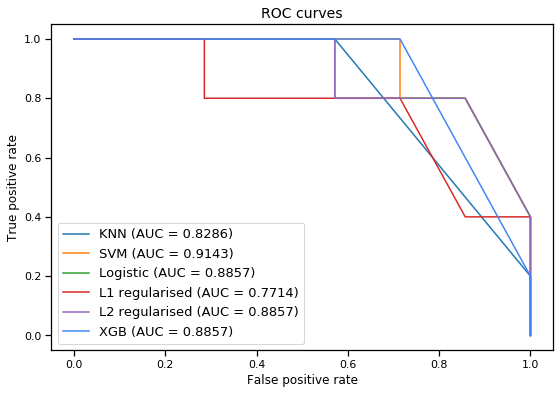

In [66]:
palette = ['#1F77B4', '#FF7F0E', '#2CA02C', '#DB2728', '#9467BD', '#4286F4','#081326']

from sklearn.metrics import roc_curve
labels=['KNN', 'SVM', 'Logistic', 'L1 regularised','L2 regularised', 'XGB']

fig, ax= plt.subplots(figsize=(9,6))

for i in range(len(rows)):
    fpr, tpr, _ = roc_curve(y_val, y_probs[i][:,1])
    auc = roc_auc_score(y_val, y_probs[i][:,1])
    ax.plot(1-fpr, tpr, label=labels[i] + ' (AUC = {:.4f})'.format(auc), color = palette[i])
    
ax.set_xlabel('False positive rate')
ax.set_ylabel('True positive rate')
ax.set_title('ROC curves', fontsize=14)
plt.legend(fontsize=13)
plt.show()